In [1]:
# Import libraries

import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

%matplotlib inline


# Preprocessing

from sklearn.preprocessing import LabelEncoder, OneHotEncoder, MinMaxScaler, StandardScaler


# Models

import xgboost as xgb
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier


# Model Evaluation

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from sklearn.metrics import RocCurveDisplay


# Explainable AI Models 

import dice_ml
from dice_ml import Dice

import shap

from aix360.algorithms.lime import LimeTabularExplainer
from anchor import anchor_tabular



# print the JS visualization code to the notebook

shap.initjs()

### Data Dictionary

* ID: Represents a unique identification of an entry
* Customer_ID: Represents a unique identification of a person
* Month: Represents the month of the year
* Name: Represents the name of a person
* Age: Represents the age of the person
* SSN: Represents the social security number of a person
* Occupation: Represents the occupation of the person
* Annual_Income: Represents the annual income of the person
* Monthly_Inhand_Salary: Represents the monthly base salary of a person
* Num_Bank_Accounts: Represents the number of bank accounts a person holds
* Num_Credit_Card: Represents the number of other credit cards held by a person
* Interest_Rate: Represents the interest rate on credit card
* Num_of_Loan: Represents the number of loans taken from the bank
* Type_of_Loan: Represents the types of loan taken by a person
* Delay_from_due_date: Represents the average number of days delayed from the payment date
* Num_of_Delayed_Payment: Represents the average number of payments delayed by a person
* Changed_Credit_Limit: Represents the percentage change in credit card limit
* Num_Credit_Inquiries: Represents the number of credit card inquiries
* Credit_Mix: Represents the classification of the mix of credits
* Outstanding_Debt: Represents the remaining debt to be paid (in USD)
* Credit_Utilization_Ratio: Represents the utilization ratio of credit card
* Credit_History_Age: Represents the age of credit history of the person
* Payment_of_Min_Amount: Represents whether only the minimum amount was paid by the person
* Total_EMI_per_month: Represents the monthly EMI payments (in USD)
* Amount_invested_monthly: Represents the monthly amount invested by the customer (in USD)
* Payment_Behaviour: Represents the payment behavior of the customer (in USD)
* Monthly_Balance: Represents the monthly balance amount of the customer (in USD)
* Credit_Score: The Outcome

### Exploratory Data Analysis

In [2]:
data_train = pd.read_csv("train.csv")

data_train.shape

(100000, 28)

In [3]:
data_train["Credit_Score"].value_counts()

Standard    53174
Poor        28998
Good        17828
Name: Credit_Score, dtype: int64

In [4]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

In [5]:
# Converts specified columns to int

columns_int = ['Age', 'Num_of_Loan']

for col in columns_int:
    data_train[col] = data_train[col].str.replace('_', '')

data_train[columns_int] = data_train[columns_int].astype(int)
data_train[columns_int] = data_train[columns_int].astype('int64')

In [6]:
# Convert specified columns to floats

columns_float = ['Changed_Credit_Limit', 'Outstanding_Debt', 
                 'Amount_invested_monthly', 'Monthly_Balance', 'Annual_Income', 'Num_of_Delayed_Payment']

for col in columns_float:
    data_train[col] = data_train[col].str.replace('_', '')


data_train[columns_float] = data_train[columns_float].replace('', np.nan)

data_train[columns_float] = data_train[columns_float].astype(float)

In [7]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  int64  
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  float64
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  int64  
 13  Type_of_Loan              88592 non-null   ob

<AxesSubplot: >

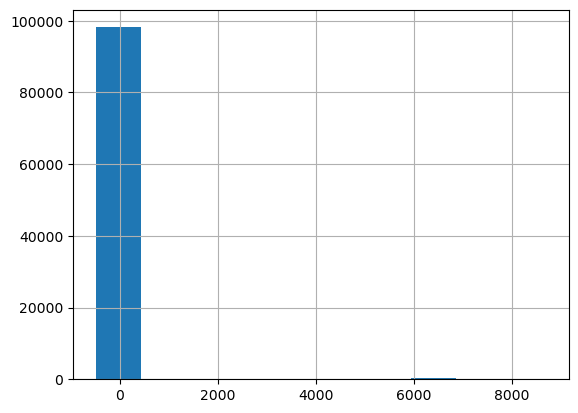

In [8]:
data_train["Age"].hist()

In [9]:
# Assuming data_train is your DataFrame

ages_below_100 = data_train[data_train["Age"] < 100]["Age"].count()
print("Total number of ages below 100:", ages_below_100)

Total number of ages below 100: 98109


### Data Cleaning 

In [10]:
data_train.isnull().sum()

ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary       15002
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit         2091
Num_Credit_Inquiries         1965
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age           9030
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      4479
Payment_Behaviour               0
Monthly_Balance              2868
Credit_Score                    0
dtype: int64

In [11]:
data_train = data_train.drop(['ID', 'SSN', 'Name', 'Customer_ID', 'Type_of_Loan', 'Occupation', 'Month'], axis = 1)

In [12]:
data_train = data_train.dropna()

data_train.isnull().sum()

Age                         0
Annual_Income               0
Monthly_Inhand_Salary       0
Num_Bank_Accounts           0
Num_Credit_Card             0
Interest_Rate               0
Num_of_Loan                 0
Delay_from_due_date         0
Num_of_Delayed_Payment      0
Changed_Credit_Limit        0
Num_Credit_Inquiries        0
Credit_Mix                  0
Outstanding_Debt            0
Credit_Utilization_Ratio    0
Credit_History_Age          0
Payment_of_Min_Amount       0
Total_EMI_per_month         0
Amount_invested_monthly     0
Payment_Behaviour           0
Monthly_Balance             0
Credit_Score                0
dtype: int64

In [13]:
# Assuming data_train is your DataFrame

ages_above_100 = data_train[data_train["Age"] > 100]["Age"].count()
print("Total number of ages above 100:", ages_above_100)

Total number of ages above 100: 1240


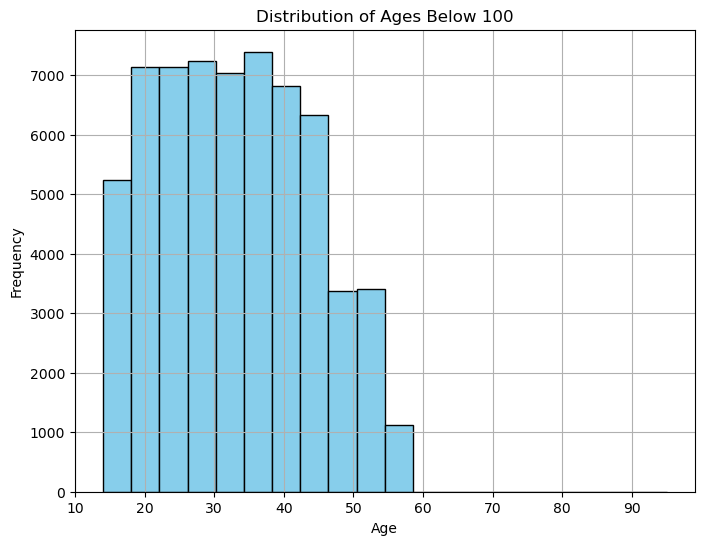

In [14]:
import matplotlib.pyplot as plt

# Assuming 'data_train' is your DataFrame containing the 'Age' column
# ages_below_100 = data_train[data_train["Age"] < 100]["Age"]

ages_below_100 = data_train[(data_train["Age"] > 0) & (data_train["Age"] < 100)]["Age"]

# Plotting a histogram
plt.figure(figsize=(8, 6))
plt.hist(ages_below_100, bins=20, color='skyblue', edgecolor='black')  # Adjust the number of bins as needed
plt.title('Distribution of Ages Below 100')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [15]:
count = data_train[(data_train["Age"] > 0) & (data_train["Age"] < 80)]["Age"].count()

print("Total number of data:", count)

Total number of data: 62224


In [16]:
creditscore = data_train[(data_train["Age"] > 0) & (data_train["Age"] < 80)]

creditscore.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 62224 entries, 0 to 98303
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Age                       62224 non-null  int64  
 1   Annual_Income             62224 non-null  float64
 2   Monthly_Inhand_Salary     62224 non-null  float64
 3   Num_Bank_Accounts         62224 non-null  int64  
 4   Num_Credit_Card           62224 non-null  int64  
 5   Interest_Rate             62224 non-null  int64  
 6   Num_of_Loan               62224 non-null  int64  
 7   Delay_from_due_date       62224 non-null  int64  
 8   Num_of_Delayed_Payment    62224 non-null  float64
 9   Changed_Credit_Limit      62224 non-null  float64
 10  Num_Credit_Inquiries      62224 non-null  float64
 11  Credit_Mix                62224 non-null  object 
 12  Outstanding_Debt          62224 non-null  float64
 13  Credit_Utilization_Ratio  62224 non-null  float64
 14  Credit

<AxesSubplot: >

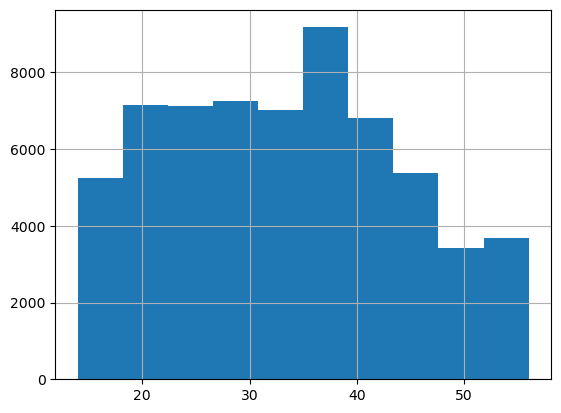

In [17]:
creditscore["Age"].hist()

In [18]:
creditscore.describe()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,62224.000000,6.222400e+04,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,62224.000000,6.222400e+04
mean,33.296445,1.770458e+05,4152.434521,16.871448,22.770330,73.560780,2.922666,21.093308,30.869616,10.412761,26.980651,1425.446923,32.316060,1419.790455,626.388699,-3.214194e+22
std,10.798319,1.442329e+06,3167.209950,116.220963,129.763779,472.114739,62.021131,14.869330,225.190459,6.790949,188.771094,1153.246598,5.098886,8338.301589,2035.068761,3.273090e+24
min,14.000000,7.005930e+03,303.645000,-1.000000,0.000000,1.000000,-100.000000,-5.000000,-3.000000,-6.480000,0.000000,0.230000,20.881250,0.000000,0.000000,-3.333333e+26
25%,24.000000,1.933908e+04,1620.165000,3.000000,4.000000,8.000000,1.000000,10.000000,9.000000,5.350000,3.000000,568.770000,28.103867,30.116962,73.427701,2.699430e+02
50%,33.000000,3.688649e+04,3050.554500,6.000000,6.000000,14.000000,3.000000,18.000000,14.000000,9.420000,6.000000,1166.080000,32.349190,68.451146,133.956885,3.360455e+02
75%,42.000000,7.211625e+04,5908.683000,7.000000,7.000000,20.000000,5.000000,28.000000,18.000000,14.940000,9.000000,1945.670000,36.509455,155.909143,258.546314,4.689619e+02
max,56.000000,2.419806e+07,15204.633000,1798.000000,1499.000000,5797.000000,1485.000000,67.000000,4397.000000,36.970000,2594.000000,4998.070000,50.000000,82331.000000,10000.000000,1.602041e+03


In [19]:
creditscore["Credit_Score"].value_counts()

Standard    33184
Poor        18061
Good        10979
Name: Credit_Score, dtype: int64

### Data Preprocessing 

#### 1. Handling Categorical Data

In [20]:
Categorical_features = ['Credit_Mix','Credit_History_Age','Payment_of_Min_Amount','Payment_Behaviour','Credit_Score']

creditscore[Categorical_features]

,Credit_Mix,Credit_History_Age,Payment_of_Min_Amount,Payment_Behaviour,Credit_Score
0,_,22 Years and 1 Months,No,High_spent_Small_value_payments,Good
6,Good,22 Years and 7 Months,No,Low_spent_Small_value_payments,Good
8,Good,26 Years and 7 Months,No,Low_spent_Small_value_payments,Standard
9,Good,26 Years and 8 Months,No,High_spent_Large_value_payments,Good
10,_,26 Years and 9 Months,No,High_spent_Large_value_payments,Standard
...,...,...,...,...,...
98296,_,24 Years and 11 Months,No,Low_spent_Small_value_payments,Standard
98298,_,25 Years and 1 Months,No,Low_spent_Small_value_payments,Standard
98299,Good,25 Years and 2 Months,NM,Low_spent_Small_value_payments,Standard
98300,Good,25 Years and 3 Months,No,High_spent_Large_value_payments,Standard


In [21]:
# Label Encoding for the Credit Score

le_Cs = LabelEncoder()

creditscore['Credit_Score'] = le_Cs.fit_transform(creditscore['Credit_Score'])

le_Cs.classes_

array(['Good', 'Poor', 'Standard'], dtype=object)

In [22]:
creditscore["Credit_Score"].value_counts()

2    33184
1    18061
0    10979
Name: Credit_Score, dtype: int64

In [23]:
# One-Hot Encoding for PaymentofMinAmount

encoder = OneHotEncoder(drop='first', sparse_output=False)

# Reshape the input data

encoded_data = encoder.fit_transform(creditscore['Payment_of_Min_Amount'].values.reshape(-1, 1))

In [24]:
encoded_data_train = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(['Payment_of_Min_Amount']))

creditscore = creditscore.reset_index(drop=True) # Resetting the index to avoid issues while concatenating

creditscore= pd.concat([creditscore, encoded_data_train], axis=1)

In [25]:
# CreditHistoryAge : replacing it with the months instead of years

creditscore_copy = creditscore

def getMonths(duration):
    years, months = int(duration.split()[0]), int(duration.split()[3])
    months += years * 12
    return months

creditscore_copy['Credit_History_Age'] = creditscore_copy['Credit_History_Age'].apply(getMonths)

In [26]:
'''
Credit_Mix : Lets use label encoding to this, 
as there is a inherent relationship between the values

'''

le_Cm = LabelEncoder()
creditscore_copy['Credit_Mix'] = le_Cm.fit_transform(creditscore_copy['Credit_Mix'])

le_Cm.classes_

array(['Bad', 'Good', 'Standard', '_'], dtype=object)

In [27]:
'''
Payment_Behaviour : Let's use one hot encoding as 
there is no inherent relationship

'''

encoder = OneHotEncoder(sparse_output=False, drop='first')

encoded_data = encoder.fit_transform(creditscore_copy['Payment_Behaviour'].values.reshape(-1, 1))

encoded_data_train = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(['Payment_Behaviour']))

creditscore = creditscore_copy.reset_index(drop=True) # Resetting the index to avoid issues while concatenating

creditscore= pd.concat([creditscore, encoded_data_train], axis=1)

In [28]:
creditscore.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62224 entries, 0 to 62223
Data columns (total 29 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Age                                                 62224 non-null  int64  
 1   Annual_Income                                       62224 non-null  float64
 2   Monthly_Inhand_Salary                               62224 non-null  float64
 3   Num_Bank_Accounts                                   62224 non-null  int64  
 4   Num_Credit_Card                                     62224 non-null  int64  
 5   Interest_Rate                                       62224 non-null  int64  
 6   Num_of_Loan                                         62224 non-null  int64  
 7   Delay_from_due_date                                 62224 non-null  int64  
 8   Num_of_Delayed_Payment                              62224 non-null  float64


In [29]:
# Dropping the left over categorical values post one hot encoding

creditscore = creditscore.drop(['Payment_of_Min_Amount', 'Payment_Behaviour'], axis = 1)

creditscore.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62224 entries, 0 to 62223
Data columns (total 27 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Age                                                 62224 non-null  int64  
 1   Annual_Income                                       62224 non-null  float64
 2   Monthly_Inhand_Salary                               62224 non-null  float64
 3   Num_Bank_Accounts                                   62224 non-null  int64  
 4   Num_Credit_Card                                     62224 non-null  int64  
 5   Interest_Rate                                       62224 non-null  int64  
 6   Num_of_Loan                                         62224 non-null  int64  
 7   Delay_from_due_date                                 62224 non-null  int64  
 8   Num_of_Delayed_Payment                              62224 non-null  float64


In [30]:
creditscore.head()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,...,Monthly_Balance,Credit_Score,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments
0,23,19114.12,1824.843,3,4,3,4,3,7.0,11.27,...,312.494089,0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,23,19114.12,1824.843,3,4,3,4,3,8.0,11.27,...,244.565317,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,28,34847.84,3037.987,2,4,6,1,3,4.0,5.42,...,470.690627,2,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,28,34847.84,3037.987,2,4,6,1,7,1.0,7.42,...,484.591214,0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,28,34847.84,3037.987,2,1385,6,1,3,-1.0,5.42,...,466.466476,2,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


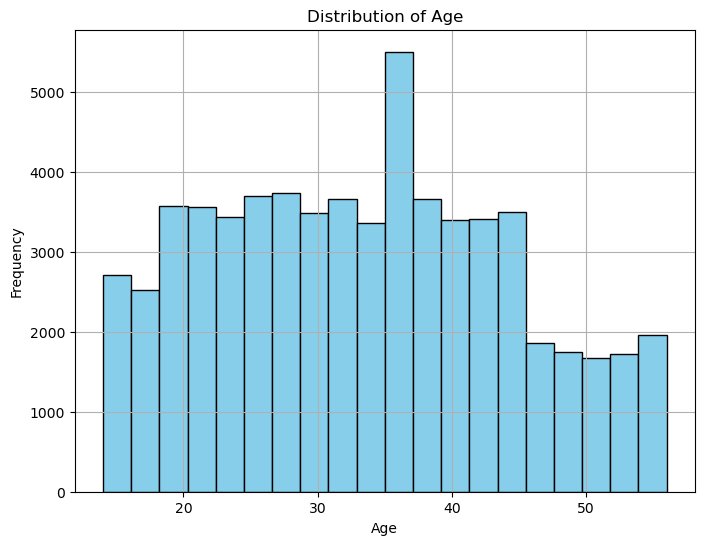

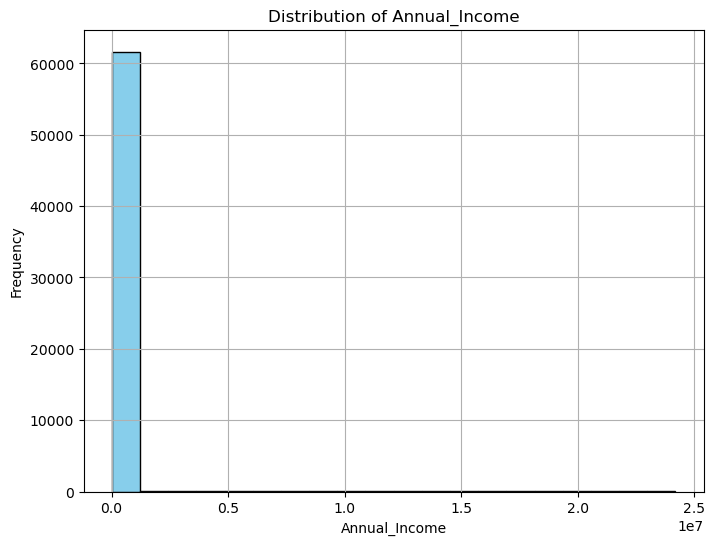

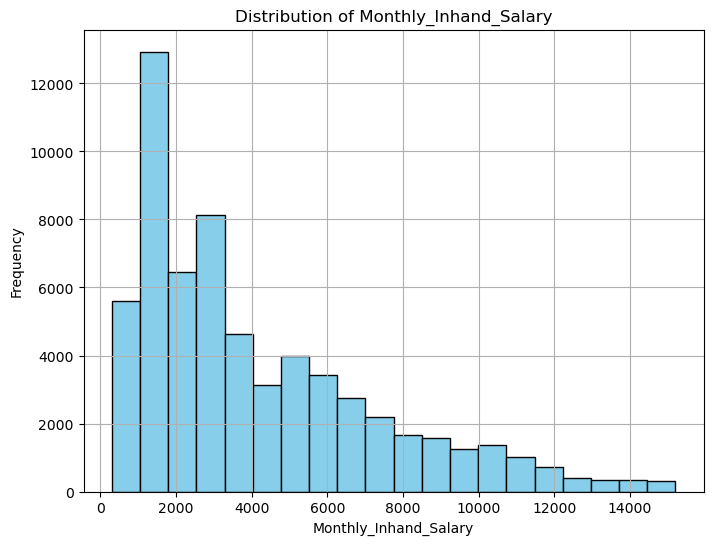

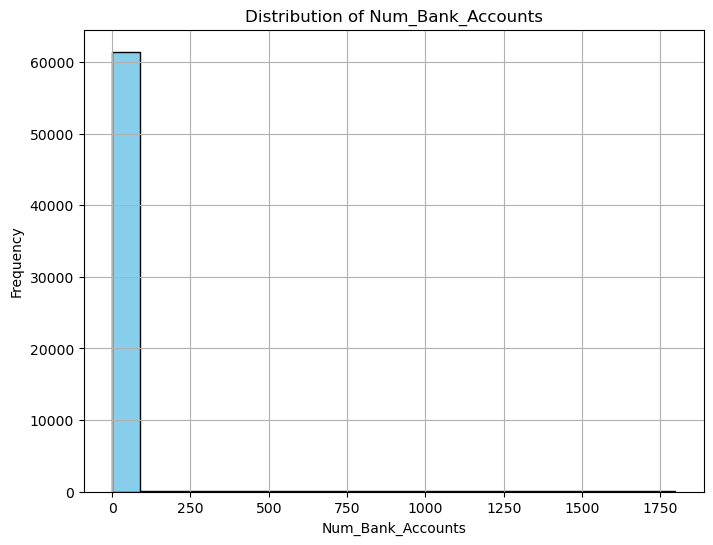

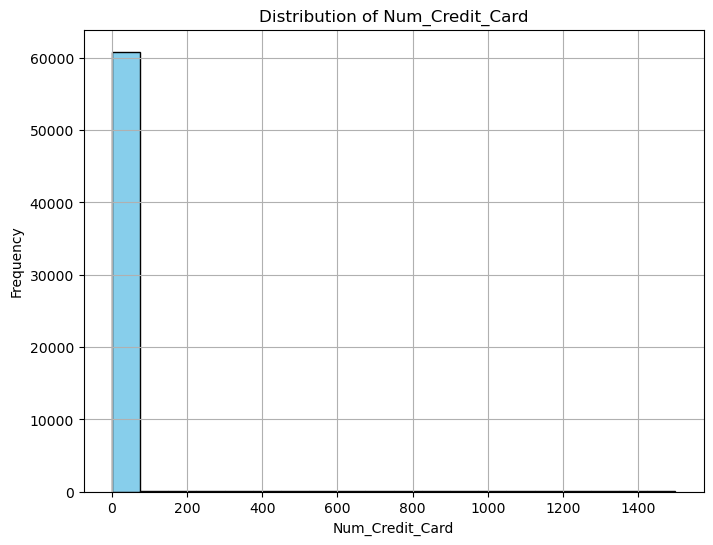

...

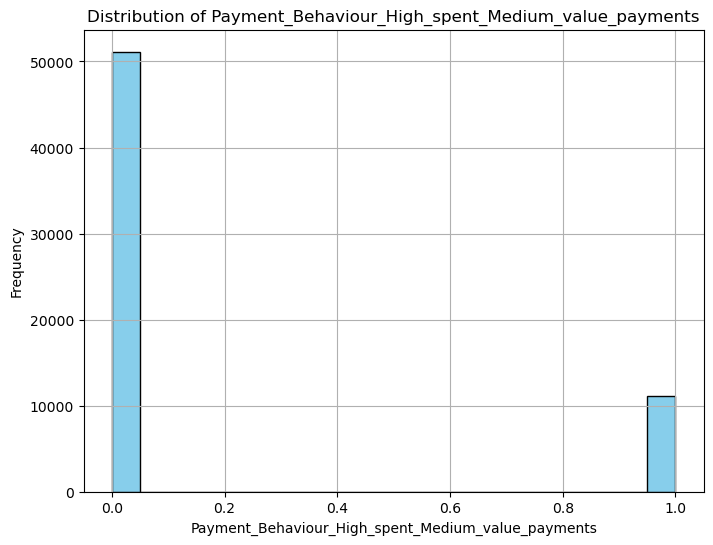

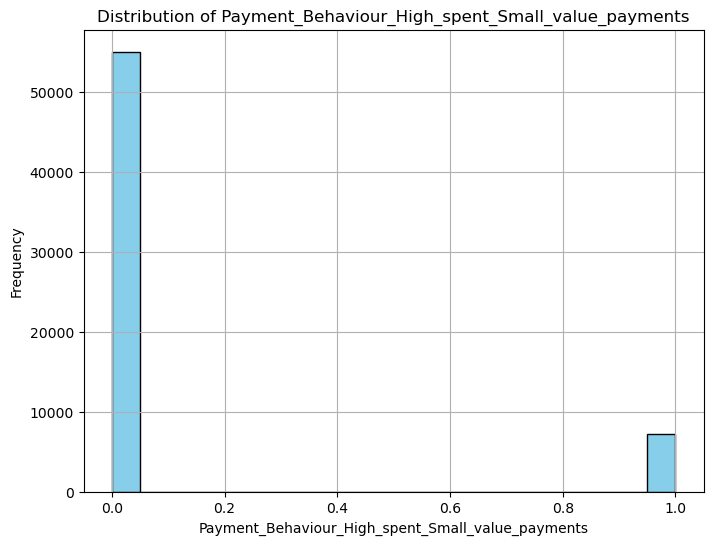

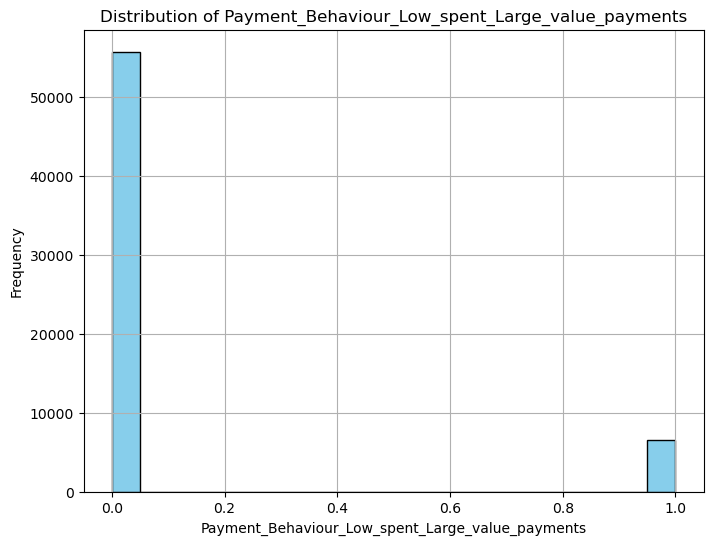

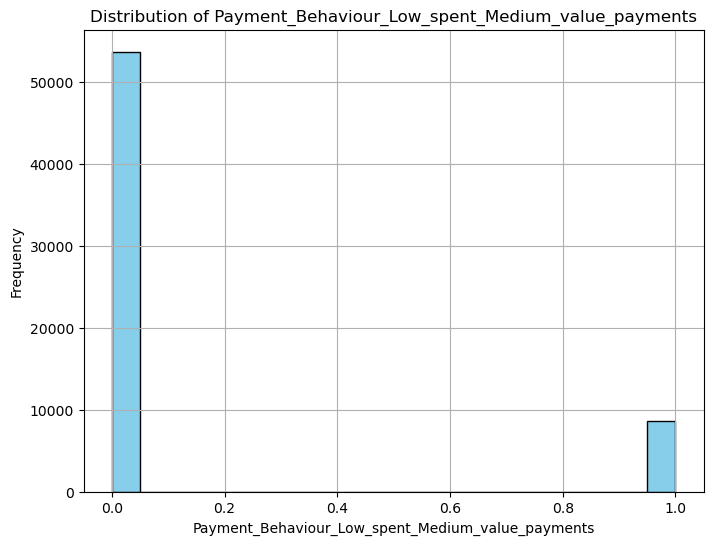

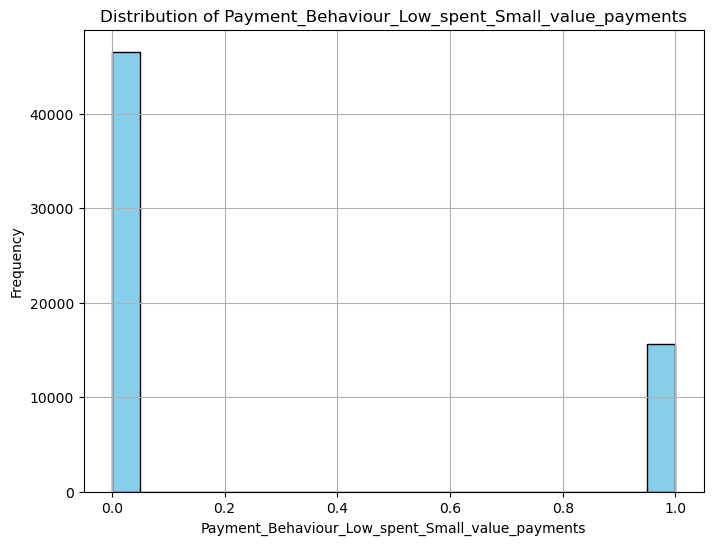

In [31]:
import matplotlib.pyplot as plt

# Assuming 'data_train' is your preprocessed DataFrame
# Loop through each numerical column and plot its histogram

for column in creditscore.select_dtypes(include='number').columns:
    plt.figure(figsize=(8, 6))
    plt.hist(creditscore[column], bins=20, color='skyblue', edgecolor='black')  # Adjust the number of bins as needed
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()


#### 2. Data Balancing

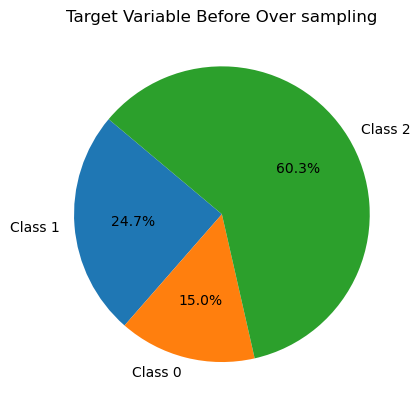

In [32]:
arr_0, arr_1, arr_2 = [], [], []

for i in creditscore['Credit_Score']:
    if i == 0:
        arr_0.append(i)
    if i == 1:
        arr_1.append(i)
    else:
        arr_2.append(i)
        
Class_1, Class_0, Class_2 = len(arr_1), len(arr_0), len(arr_2)


plt.pie([Class_1, Class_0, Class_2], labels=['Class 1', 'Class 0', 'Class 2'], autopct='%1.1f%%', startangle=140)

plt.title('Target Variable Before Over sampling')
plt.show()

In [33]:
# Class_2 represents the size of the majority class

Class_2 = len(creditscore[creditscore['Credit_Score'] == 2])

# Splitting the dataset based on 'Credit_Score'

data_class_1 = creditscore[creditscore['Credit_Score'] == 1]
data_class_2 = creditscore[creditscore['Credit_Score'] == 2]
data_class_0 = creditscore[creditscore['Credit_Score'] == 0]

# Oversampling the minority classes

data_class_1_oversampled = data_class_1.sample(n=Class_2, replace=True)
data_class_0_oversampled = data_class_0.sample(n=Class_2, replace=True)

# Concatenating the oversampled data with the majority class

data_oversampled = pd.concat([data_class_2, data_class_1_oversampled, data_class_0_oversampled], axis=0)

# Optional: Shuffle the oversampled data

data_oversampled = data_oversampled.sample(frac=1).reset_index(drop=True)

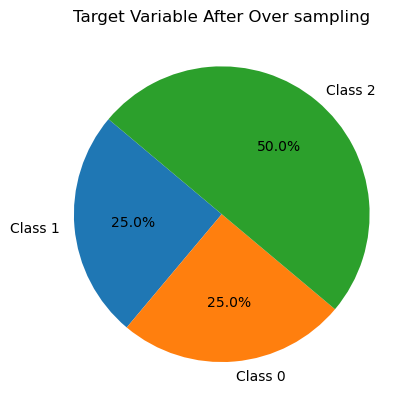

In [34]:
arr_0, arr_1, arr_2 = [], [], []

for i in data_oversampled['Credit_Score']:
    if i == 0:
        arr_0.append(i)
    if i == 1:
        arr_1.append(i)
    else:
        arr_2.append(i)
        
Class_1, Class_0, Class_2 = len(arr_1), len(arr_0), len(arr_2)


plt.pie([Class_1, Class_0, Class_2], labels=['Class 1', 'Class 0', 'Class 2'], autopct='%1.1f%%', startangle=140)

plt.title('Target Variable After Over sampling')
plt.show()

#### 3. Outlier Removal

Text(0.5, 1.0, 'Boxplots for Multiple Columns')

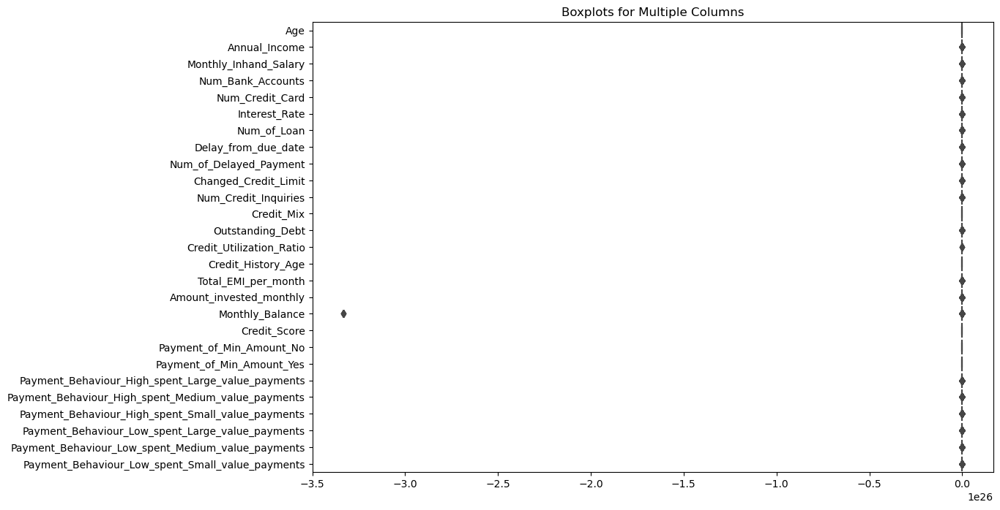

In [35]:
plt.figure(figsize=(12, 8))  

sns.boxplot(data=data_oversampled, orient='h')  # orient='h' for horizontal boxplots

plt.title('Boxplots for Multiple Columns')

In [36]:
data_oversampled.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99552 entries, 0 to 99551
Data columns (total 27 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Age                                                 99552 non-null  int64  
 1   Annual_Income                                       99552 non-null  float64
 2   Monthly_Inhand_Salary                               99552 non-null  float64
 3   Num_Bank_Accounts                                   99552 non-null  int64  
 4   Num_Credit_Card                                     99552 non-null  int64  
 5   Interest_Rate                                       99552 non-null  int64  
 6   Num_of_Loan                                         99552 non-null  int64  
 7   Delay_from_due_date                                 99552 non-null  int64  
 8   Num_of_Delayed_Payment                              99552 non-null  float64


In [37]:
df = data_oversampled.drop('Credit_Score', axis = 1)

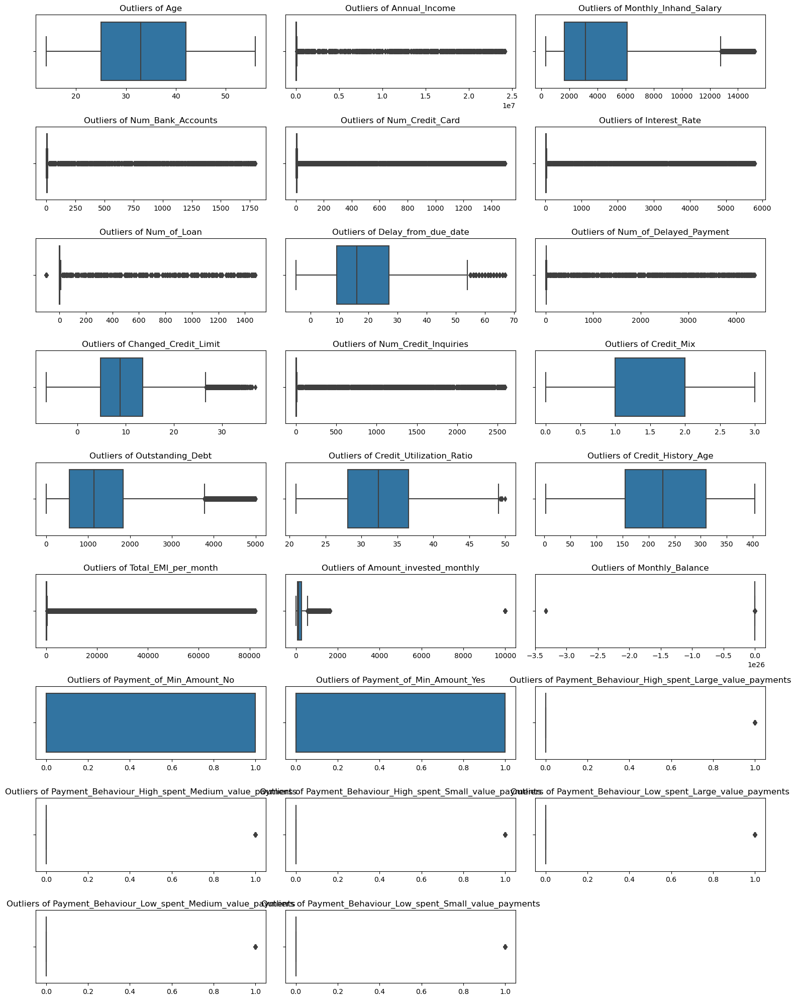

In [38]:
num_cols = 3

num_features = len(df.columns)
num_rows = (num_features - 1) // num_cols + 1

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 20))

# Flattenning the axes

axes = axes.ravel()

i = -1
for feature in df.columns:
    i += 1
    ax = axes[i]
    sns.boxplot(x=df[feature], ax = ax)
    ax.set_title(f'Outliers of {feature}')
    ax.set_xlabel('')
    ax.set_ylabel('')

for i in range(num_features, num_cols * num_rows):
    fig.delaxes(axes[i])
    
plt.tight_layout()
plt.show()

In [39]:
df['Credit_Score'] = data_oversampled['Credit_Score']

In [40]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1

# print(IQR)

print(df < (Q1 - 1.5 * IQR) |(df > (Q3 + 1.5 * IQR)))

         Age  Annual_Income  Monthly_Inhand_Salary  Num_Bank_Accounts  \
0      False          False                  False              False   
1      False          False                  False              False   
2      False          False                  False              False   
3      False          False                  False              False   
4      False          False                  False              False   
...      ...            ...                    ...                ...   
99547  False          False                  False              False   
99548  False          False                  False              False   
99549  False          False                  False              False   
99550  False          False                  False              False   
99551  False          False                  False              False   

       Num_Credit_Card  Interest_Rate  Num_of_Loan  Delay_from_due_date  \
0                False          False        Fal

In [41]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1

print(df < (Q1 - 1.5 * IQR) |(df > (Q3 + 1.5 * IQR)))

         Age  Annual_Income  Monthly_Inhand_Salary  Num_Bank_Accounts  \
0      False          False                  False              False   
1      False          False                  False              False   
2      False          False                  False              False   
3      False          False                  False              False   
4      False          False                  False              False   
...      ...            ...                    ...                ...   
99547  False          False                  False              False   
99548  False          False                  False              False   
99549  False          False                  False              False   
99550  False          False                  False              False   
99551  False          False                  False              False   

       Num_Credit_Card  Interest_Rate  Num_of_Loan  Delay_from_due_date  \
0                False          False        Fal

In [42]:
s = set([
    'Payment_of_Min_Amount_No',
    'Payment_of_Min_Amount_Yes',
    'Payment_Behaviour_High_spent_Large_value_payments',
    'Payment_Behaviour_High_spent_Medium_value_payments',
    'Payment_Behaviour_High_spent_Small_value_payments',
    'Payment_Behaviour_Low_spent_Large_value_payments',
    'Payment_Behaviour_Low_spent_Medium_value_payments',
    'Payment_Behaviour_Low_spent_Small_value_payments',
    'Age',
    'Num_Bank_Accounts',
    'Num_Credit_Card',
    'Interest_Rate',
    'Num_of_Loan',
    'Num_of_Delayed_Payment',
    'Num_Credit_Inquiries'
])

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
for column in df.columns:
    if column in s:
        continue
    df = df[(df[column] >= lower_bound[column]) & (df[column] <= upper_bound[column])]

print(df)

       Age  Annual_Income  Monthly_Inhand_Salary  Num_Bank_Accounts  \
0       50      109600.95               9336.413                  4   
1       46       99776.28               8051.690                  5   
3       28       40646.19               3276.183                  3   
6       20       15961.55               1269.129                  5   
7       31       10455.88                729.323                  6   
...    ...            ...                    ...                ...   
99547   53       22385.16               2077.430                  8   
99548   33       17416.75               1243.396                  5   
99549   37       20175.44               1782.287                 10   
99550   14       16897.53               1165.127                  5   
99551   54       17853.50               1226.792                  5   

       Num_Credit_Card  Interest_Rate  Num_of_Loan  Delay_from_due_date  \
0                    7              1            3                   14 

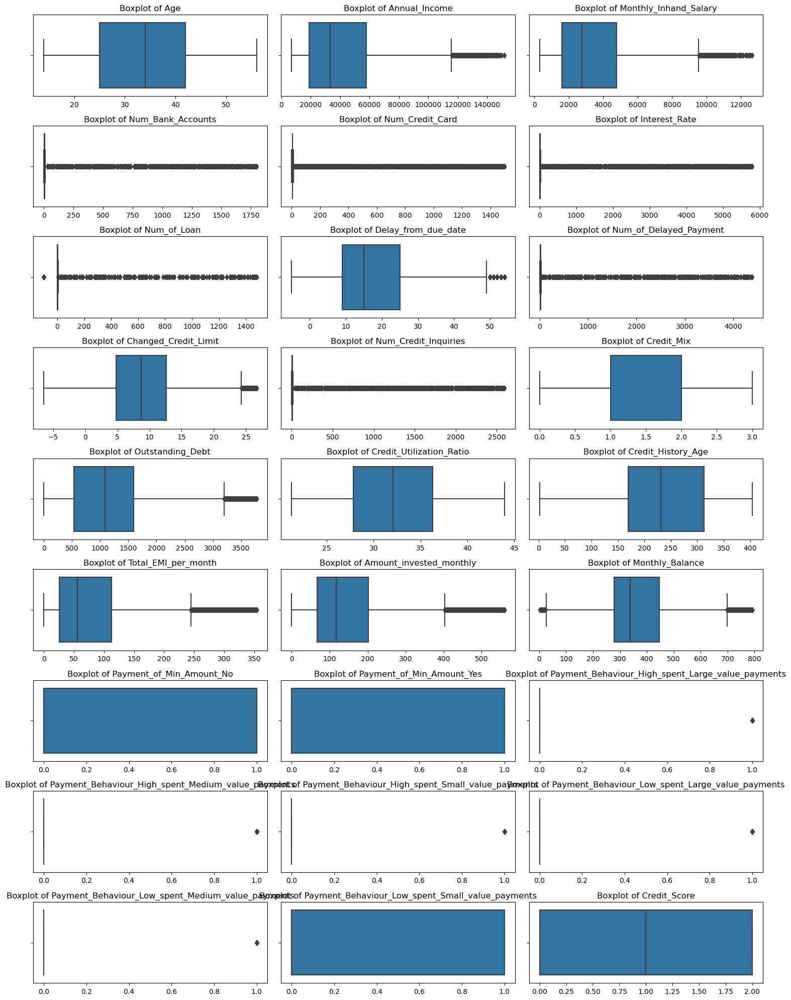

In [43]:
num_cols = 3

num_features = len(df.columns)
num_rows = (num_features - 1) // num_cols + 1

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 20))

# Flattenning the axes

axes = axes.ravel()

i = -1

for feature in df.columns:
    
    i += 1
    ax = axes[i]
    sns.boxplot(x=df[feature], ax = ax)
    ax.set_title(f'Boxplot of {feature}')
    ax.set_xlabel('')
    ax.set_ylabel('')
    
for i in range(num_features, num_cols * num_rows):
    fig.delaxes(axes[i])
    
plt.tight_layout()
plt.show()

In [44]:
df.reset_index(drop=True)

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,...,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,50,109600.95,9336.413,4,7,1,3,14,4.0,3.93,...,631.826028,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0
1,46,99776.28,8051.690,5,7,6,4,14,15.0,5.34,...,542.559601,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0
2,28,40646.19,3276.183,3,7,6,0,12,5.0,4.77,...,262.491940,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2
3,20,15961.55,1269.129,5,2,11,2,3,6.0,6.88,...,272.370868,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2
4,31,10455.88,729.323,6,5,12,3,11,19.0,9.71,...,302.693340,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67649,53,22385.16,2077.430,8,7,17,1,28,9.0,-4.26,...,373.291039,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2
67650,33,17416.75,1243.396,5,6,1439,4,10,10.0,10.10,...,250.835369,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
67651,37,20175.44,1782.287,10,7,23,3,35,18.0,9.18,...,366.621032,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1
67652,14,16897.53,1165.127,5,4,25,4,24,18.0,7.85,...,312.733999,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1


Text(0.5, 1.0, 'Boxplots for Multiple Columns')

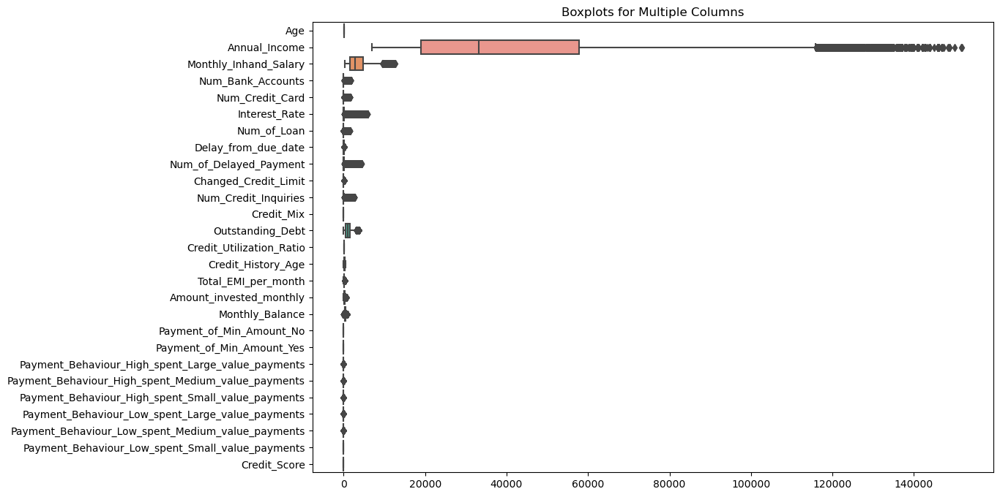

In [45]:
plt.figure(figsize=(12, 8))  # Adjust the figure size as needed

# Use Seaborn to create boxplots for all columns in df

sns.boxplot(data=df, orient='h')  # orient='h' for horizontal boxplots
plt.title('Boxplots for Multiple Columns')

#### 4. Feature Scaling 

Text(0.5, 1.0, 'Boxplots for Multiple Columns')

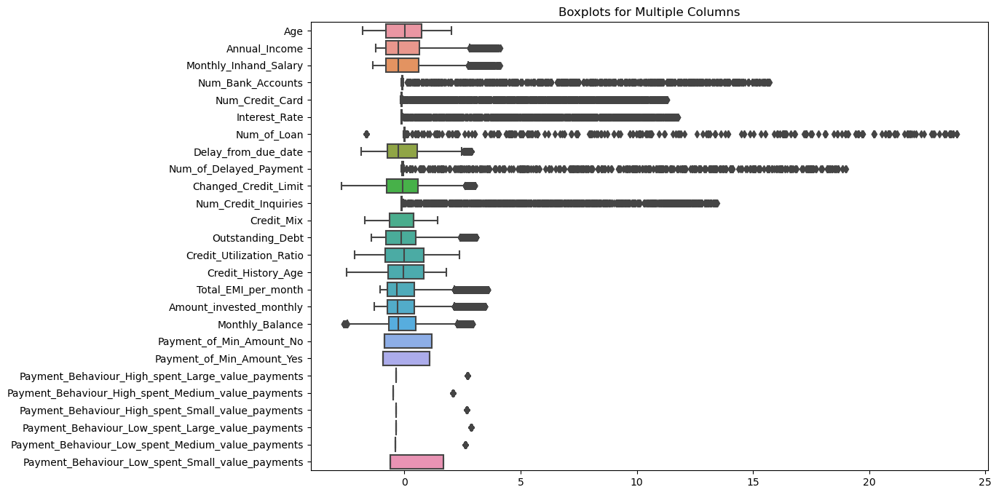

In [46]:
df_without_outliers  = df.copy()

sc = StandardScaler()
sc.fit(df_without_outliers.drop('Credit_Score', axis = 1))
data_oversampled_normalized_without_outliers = sc.transform(df_without_outliers.drop('Credit_Score', axis = 1))
data_oversampled_normalized_without_outliers = pd.DataFrame(data_oversampled_normalized_without_outliers, columns = df_without_outliers.drop('Credit_Score', axis = 1).columns)

plt.figure(figsize=(12, 8))  # Adjust the figure size as needed

# Use Seaborn to create boxplots for all columns in df

sns.boxplot(data=data_oversampled_normalized_without_outliers, orient='h')  # orient='h' for horizontal boxplots
plt.title('Boxplots for Multiple Columns')

In [47]:
data_oversampled_normalized_without_outliers = pd.DataFrame(data_oversampled_normalized_without_outliers, 
                                                            columns=df_without_outliers.columns.difference(['Credit_Score']))


data_oversampled_normalized_without_outliers['Credit_Score'] = df_without_outliers.reset_index()['Credit_Score']

data_oversampled_normalized_without_outliers

,Age,Amount_invested_monthly,Annual_Income,Changed_Credit_Limit,Credit_History_Age,Credit_Mix,Credit_Utilization_Ratio,Delay_from_due_date,Interest_Rate,Monthly_Balance,...,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Total_EMI_per_month,Credit_Score
0,1.478213,1.247969,2.565873,-0.915617,-0.105411,-0.652867,-0.349305,-0.335399,-0.153251,1.802268,...,-0.368642,2.084815,-0.374182,-0.347409,-0.382732,-0.595481,1.170363,-0.916910,2.255169,0
1,1.112499,0.452934,2.201281,-0.671185,1.354814,-0.652867,0.716691,-0.335399,-0.142955,1.175438,...,2.712662,-0.479659,-0.374182,-0.347409,-0.382732,-0.595481,1.170363,-0.916910,2.832540,0
2,-0.533213,1.723436,0.006977,-0.769998,0.310273,-0.652867,0.028900,-0.495635,-0.142955,-0.791200,...,-0.368642,-0.479659,-0.374182,-0.347409,-0.382732,1.679316,-0.854436,-0.916910,-1.053324,2
3,-1.264641,-0.252843,-0.909065,-0.404218,0.086443,-0.652867,0.568119,-1.216699,-0.132658,-0.721830,...,-0.368642,-0.479659,-0.374182,-0.347409,-0.382732,1.679316,1.170363,-0.916910,-0.774868,2
4,-0.258928,-1.095098,-1.113379,0.086379,0.470152,-0.652867,-0.517741,-0.575753,-0.130599,-0.508905,...,-0.368642,-0.479659,-0.374182,-0.347409,2.612796,-0.595481,1.170363,-0.916910,-0.715897,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67649,1.752498,-0.382892,-0.670686,-2.335401,-0.457144,0.394240,1.196300,0.786256,-0.120303,-0.013168,...,-0.368642,-0.479659,-0.374182,-0.347409,-0.382732,1.679316,1.170363,-0.916910,-0.838220,2
67650,-0.076071,-0.221715,-0.855062,0.153988,1.365473,-0.652867,-0.178513,-0.655872,2.807960,-0.873053,...,-0.368642,-0.479659,-0.374182,-0.347409,-0.382732,1.679316,1.170363,-0.916910,-0.574225,0
67651,0.289643,-1.124741,-0.752688,-0.005499,-0.105411,-1.699974,1.237112,1.347083,-0.107947,-0.060004,...,2.712662,-0.479659,-0.374182,-0.347409,-0.382732,-0.595481,-0.854436,1.090619,-0.652390,1
67652,-1.813212,-1.017994,-0.874331,-0.236062,-0.776902,0.394240,0.689555,0.465783,-0.103829,-0.438400,...,-0.368642,-0.479659,-0.374182,-0.347409,2.612796,-0.595481,-0.854436,1.090619,-0.394897,1


In [48]:
scoringdata = data_oversampled_normalized_without_outliers.copy()

scoringdata

,Age,Amount_invested_monthly,Annual_Income,Changed_Credit_Limit,Credit_History_Age,Credit_Mix,Credit_Utilization_Ratio,Delay_from_due_date,Interest_Rate,Monthly_Balance,...,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Total_EMI_per_month,Credit_Score
0,1.478213,1.247969,2.565873,-0.915617,-0.105411,-0.652867,-0.349305,-0.335399,-0.153251,1.802268,...,-0.368642,2.084815,-0.374182,-0.347409,-0.382732,-0.595481,1.170363,-0.916910,2.255169,0
1,1.112499,0.452934,2.201281,-0.671185,1.354814,-0.652867,0.716691,-0.335399,-0.142955,1.175438,...,2.712662,-0.479659,-0.374182,-0.347409,-0.382732,-0.595481,1.170363,-0.916910,2.832540,0
2,-0.533213,1.723436,0.006977,-0.769998,0.310273,-0.652867,0.028900,-0.495635,-0.142955,-0.791200,...,-0.368642,-0.479659,-0.374182,-0.347409,-0.382732,1.679316,-0.854436,-0.916910,-1.053324,2
3,-1.264641,-0.252843,-0.909065,-0.404218,0.086443,-0.652867,0.568119,-1.216699,-0.132658,-0.721830,...,-0.368642,-0.479659,-0.374182,-0.347409,-0.382732,1.679316,1.170363,-0.916910,-0.774868,2
4,-0.258928,-1.095098,-1.113379,0.086379,0.470152,-0.652867,-0.517741,-0.575753,-0.130599,-0.508905,...,-0.368642,-0.479659,-0.374182,-0.347409,2.612796,-0.595481,1.170363,-0.916910,-0.715897,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67649,1.752498,-0.382892,-0.670686,-2.335401,-0.457144,0.394240,1.196300,0.786256,-0.120303,-0.013168,...,-0.368642,-0.479659,-0.374182,-0.347409,-0.382732,1.679316,1.170363,-0.916910,-0.838220,2
67650,-0.076071,-0.221715,-0.855062,0.153988,1.365473,-0.652867,-0.178513,-0.655872,2.807960,-0.873053,...,-0.368642,-0.479659,-0.374182,-0.347409,-0.382732,1.679316,1.170363,-0.916910,-0.574225,0
67651,0.289643,-1.124741,-0.752688,-0.005499,-0.105411,-1.699974,1.237112,1.347083,-0.107947,-0.060004,...,2.712662,-0.479659,-0.374182,-0.347409,-0.382732,-0.595481,-0.854436,1.090619,-0.652390,1
67652,-1.813212,-1.017994,-0.874331,-0.236062,-0.776902,0.394240,0.689555,0.465783,-0.103829,-0.438400,...,-0.368642,-0.479659,-0.374182,-0.347409,2.612796,-0.595481,-0.854436,1.090619,-0.394897,1


In [49]:
scoringdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67654 entries, 0 to 67653
Data columns (total 27 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Age                                                 67654 non-null  float64
 1   Amount_invested_monthly                             67654 non-null  float64
 2   Annual_Income                                       67654 non-null  float64
 3   Changed_Credit_Limit                                67654 non-null  float64
 4   Credit_History_Age                                  67654 non-null  float64
 5   Credit_Mix                                          67654 non-null  float64
 6   Credit_Utilization_Ratio                            67654 non-null  float64
 7   Delay_from_due_date                                 67654 non-null  float64
 8   Interest_Rate                                       67654 non-null  float64


In [50]:
scoringdata.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,67654.0,-8.251103e-17,1.000007,-1.813212,-0.807499,0.015357,0.746785,2.026784
Amount_invested_monthly,67654.0,-3.688319e-18,1.000007,-1.303869,-0.731458,-0.303438,0.415750,3.471944
Annual_Income,67654.0,2.537362e-17,1.000007,-1.241406,-0.797602,-0.267903,0.641431,4.133895
Changed_Credit_Limit,67654.0,8.089298e-17,1.000007,-2.713316,-0.759597,-0.085243,0.589111,3.023026
Credit_History_Age,67654.0,1.600949e-17,1.000007,-2.482275,-0.702292,-0.041460,0.832544,1.802475
Credit_Mix,67654.0,-4.168842e-16,1.000007,-1.699974,-0.652867,0.394240,0.394240,1.441347
Credit_Utilization_Ratio,67654.0,4.362451e-16,1.000007,-2.150664,-0.840173,0.001525,0.841371,2.366039
Delay_from_due_date,67654.0,-1.160873e-16,1.000007,-1.857644,-0.735990,-0.255281,0.545901,2.869329
Interest_Rate,67654.0,4.729246e-17,1.000007,-0.153251,-0.140896,-0.130599,-0.116184,11.782199
Monthly_Balance,67654.0,1.564723e-17,1.000007,-2.622276,-0.684567,-0.255778,0.498181,2.924564


#### Data Cleaned

## Model Building

In [51]:
# Spliting the data into training and test set

X = df.drop('Credit_Score', axis=1)
y = df['Credit_Score']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=24)

#### 1. Randon Forest

In [52]:
rdf_model = RandomForestClassifier(random_state=24)

rdf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=24)

In [53]:
# Testing on the train data

y_preds_rdf_train = rdf_model.predict(X_train)

accuracy_rdf_train = accuracy_score(y_train, y_preds_rdf_train)

print(f'Accuracy: {accuracy_rdf_train:.2f}')
print(classification_report(y_train, y_preds_rdf_train))

Accuracy: 1.00
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     15447
           1       1.00      1.00      1.00     15565
           2       1.00      1.00      1.00     16345

    accuracy                           1.00     47357
   macro avg       1.00      1.00      1.00     47357
weighted avg       1.00      1.00      1.00     47357



In [54]:
# Testing on the test data

y_preds_rdf = rdf_model.predict(X_test)

accuracy_rdf = accuracy_score(y_test, y_preds_rdf)

print(f'Accuracy: {accuracy_rdf:.2f}')
print(classification_report(y_test, y_preds_rdf))

Accuracy: 0.89
              precision    recall  f1-score   support

           0       0.88      0.97      0.92      6689
           1       0.88      0.94      0.91      6636
           2       0.92      0.77      0.84      6972

    accuracy                           0.89     20297
   macro avg       0.89      0.89      0.89     20297
weighted avg       0.89      0.89      0.89     20297



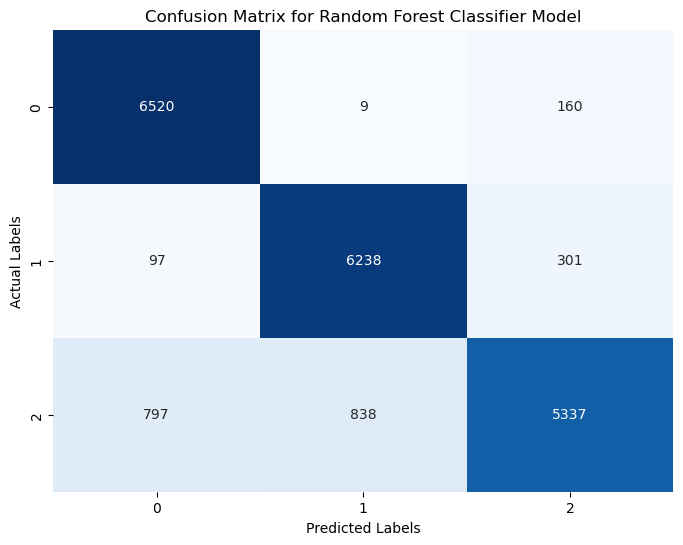

In [55]:
rdf_confusion = confusion_matrix(y_test, y_preds_rdf)

plt.figure(figsize=(8, 6))
sns.heatmap(rdf_confusion, annot=True, fmt='d', cmap='Blues', cbar=False)

plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix for Random Forest Classifier Model')

plt.show()

#### 2. Decision Trees

In [56]:
decision_tree_model = DecisionTreeClassifier(random_state=24) 

decision_tree_model.fit(X_train, y_train)

y_pred_decision = decision_tree_model.predict(X_test)

In [57]:
accuracy_decision = accuracy_score(y_test, y_pred_decision)

print(f'Accuracy: {accuracy_decision:.2f}')
print(classification_report(y_test, y_pred_decision))

Accuracy: 0.86
              precision    recall  f1-score   support

           0       0.87      0.95      0.91      6689
           1       0.84      0.90      0.87      6636
           2       0.86      0.71      0.78      6972

    accuracy                           0.86     20297
   macro avg       0.86      0.86      0.85     20297
weighted avg       0.86      0.86      0.85     20297



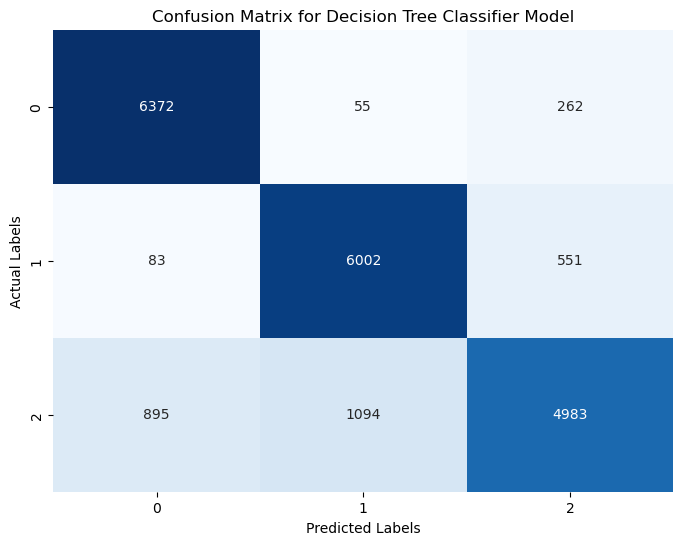

In [58]:
de_confusion = confusion_matrix(y_test, y_pred_decision)

plt.figure(figsize=(8, 6))
sns.heatmap(de_confusion, annot=True, fmt='d', cmap='Blues', cbar=False)

plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix for Decision Tree Classifier Model')

plt.show()

#### 3. XGBoost

In [59]:
xgb_model = xgb.XGBClassifier(objective='multi:softmax', num_class=3, random_state=24)

xgb_model.fit(X_train, y_train)

y_pred_xgb = xgb_model.predict(X_test)

In [60]:
accuracy_xgb = accuracy_score(y_test, y_pred_xgb)

print(f'Accuracy: {accuracy_xgb:.2f}')
print(classification_report(y_test, y_pred_xgb))

Accuracy: 0.83
              precision    recall  f1-score   support

           0       0.82      0.92      0.87      6689
           1       0.85      0.87      0.86      6636
           2       0.82      0.71      0.76      6972

    accuracy                           0.83     20297
   macro avg       0.83      0.83      0.83     20297
weighted avg       0.83      0.83      0.83     20297



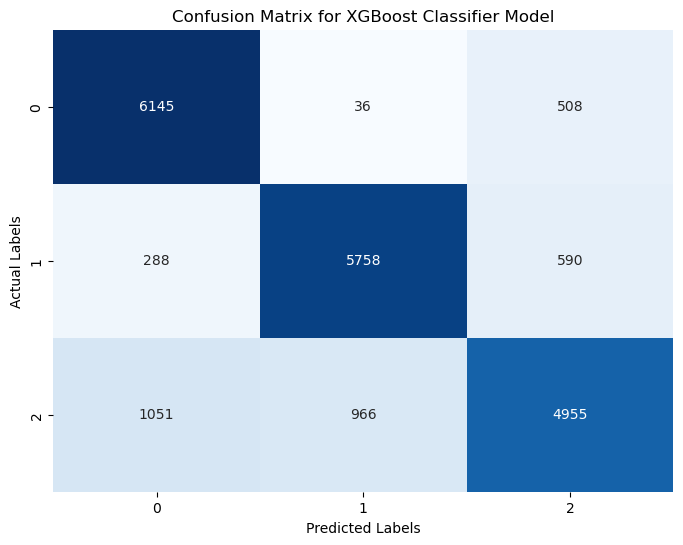

In [61]:
xgb_confusion = confusion_matrix(y_test, y_pred_xgb)

plt.figure(figsize=(8, 6))
sns.heatmap(xgb_confusion, annot=True, fmt='d', cmap='Blues', cbar=False)

plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix for XGBoost Classifier Model')
plt.show()

#### Baseline model comparison

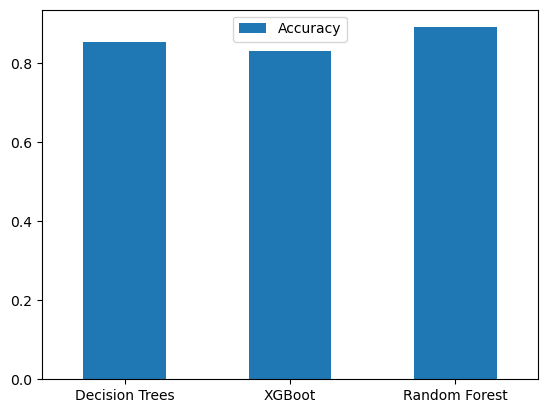

In [62]:
model_scores = {"Decision Trees": accuracy_decision,
                 "XGBoot": accuracy_xgb,
                 "Random Forest": accuracy_rdf}

model_compare = pd.DataFrame(model_scores, index=["Accuracy"])

model_compare.T.plot.bar()
plt.xticks(rotation = 0);

### Hyperparameter Tuning with RandomizedSearchCV

* Tuning the hyperparameter to find the parameter for a better classification

In [63]:
# Hyperparameter grid for Random Forest

rf_grid = {
    "n_estimators": np.arange(10, 100, 50),
    "max_depth": [None, 3, 5, 10],
    "min_samples_split": np.arange(2, 20, 2),
    "min_samples_leaf": np.arange(1, 20, 2)
}

# Hyperparameter grid for Decision Tree

dt_grid = {
    "max_depth": [None, 3, 5, 10],
    "min_samples_split": np.arange(2, 20, 2),
    "min_samples_leaf": np.arange(1, 20, 2)
}

# Hyperparameter grid for XGBoost 

xgb_grid = {
    "n_estimators": np.arange(10, 100, 50),
    "max_depth": [3, 5, 7],
    "learning_rate": [0.01, 0.1, 0.3],
    "min_child_weight": [1, 3, 5],
    "subsample": [0.5, 0.7, 1.0],
    "colsample_bytree": [0.5, 0.7, 1.0]
}

#### 1. Grid Search on Decision Tree

In [64]:
# Setup grid hyperparameter search for Decision Tree

de_rscv = RandomizedSearchCV(DecisionTreeClassifier(random_state=24),
                         param_distributions=dt_grid,
                         cv=5, n_iter=30, verbose=True)


# Fit random hyperparameter search model for Decision Tree

de_rscv.fit(X_train, y_train)

Fitting 5 folds for each of 30 candidates, totalling 150 fits


RandomizedSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=24),
                   n_iter=30,
                   param_distributions={'max_depth': [None, 3, 5, 10],
                                        'min_samples_leaf': array([ 1,  3,  5,  7,  9, 11, 13, 15, 17, 19]),
                                        'min_samples_split': array([ 2,  4,  6,  8, 10, 12, 14, 16, 18])},
                   verbose=True)

In [65]:
de_rscv.best_params_

{'min_samples_split': 6, 'min_samples_leaf': 13, 'max_depth': None}

In [66]:
y_preds_de_rscv = de_rscv.predict(X_test)

accuracy_de_rscv = accuracy_score(y_test, y_preds_de_rscv)

print(f'Accuracy: {accuracy_de_rscv:.2f}')
print(classification_report(y_test, y_preds_de_rscv))

Accuracy: 0.77
              precision    recall  f1-score   support

           0       0.79      0.84      0.81      6689
           1       0.78      0.82      0.80      6636
           2       0.73      0.64      0.69      6972

    accuracy                           0.77     20297
   macro avg       0.77      0.77      0.77     20297
weighted avg       0.77      0.77      0.76     20297



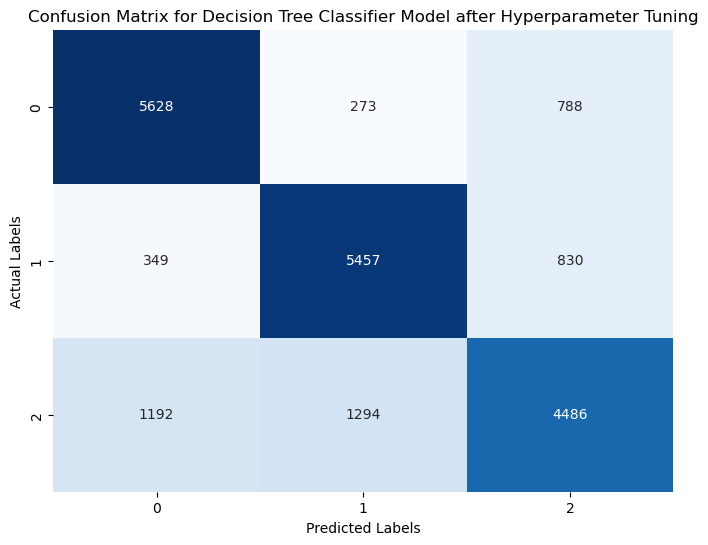

In [67]:
de_rscv_confusion = confusion_matrix(y_test, y_preds_de_rscv)

plt.figure(figsize=(8, 6))
sns.heatmap(de_rscv_confusion, annot=True, fmt='d', cmap='Blues', cbar=False)

plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix for Decision Tree Classifier Model after Hyperparameter Tuning')

plt.show()

#### 2. Grid Search on XGBoost

In [68]:
# Setup grid hyperparameter search for XGBoost

xgb_rscv = RandomizedSearchCV(xgb.XGBClassifier(objective='multi:softmax', num_class=3, random_state=24),
                         param_distributions=xgb_grid,
                         cv=5, n_iter=150, verbose=True)


# Fit random hyperparameter search model for XGBoost

xgb_rscv.fit(X_train, y_train)

Fitting 5 folds for each of 150 candidates, totalling 750 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=None, grow_policy=None,
                                           importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate...
                                           min_child_weight=None, missing=nan,
                                           monotone_constraints=None,
                                           multi_strategy=None,
                                           n_estimators=None, n_jobs=None,
                                           num_class=3, num_parallel_tree=None, ...),
                   n_iter=150,
                   param_distributions={'colsample_bytree': [0.5, 0.7, 1.0],
                                        'learning_rate': [0.01, 0.1, 0.3],
                                        'max_depth': [3, 5, 7],
                                        'min_child_weight': [1, 3, 5],
                                        'n_estimators': array([10, 60]),
                                        'subsample': [0.5, 0.7, 1.0]},
                   verbose=True)

In [69]:
xgb_rscv.best_params_

{'subsample': 0.7,
 'n_estimators': 60,
 'min_child_weight': 1,
 'max_depth': 7,
 'learning_rate': 0.3,
 'colsample_bytree': 1.0}

In [70]:
y_preds_xgb_rscv = xgb_rscv.predict(X_test)

accuracy_xgb_rscv = accuracy_score(y_test, y_preds_xgb_rscv)

print(f'Accuracy: {accuracy_xgb_rscv:.2f}')
print(classification_report(y_test, y_preds_xgb_rscv))

Accuracy: 0.83
              precision    recall  f1-score   support

           0       0.82      0.93      0.87      6689
           1       0.85      0.87      0.86      6636
           2       0.82      0.71      0.76      6972

    accuracy                           0.83     20297
   macro avg       0.83      0.84      0.83     20297
weighted avg       0.83      0.83      0.83     20297



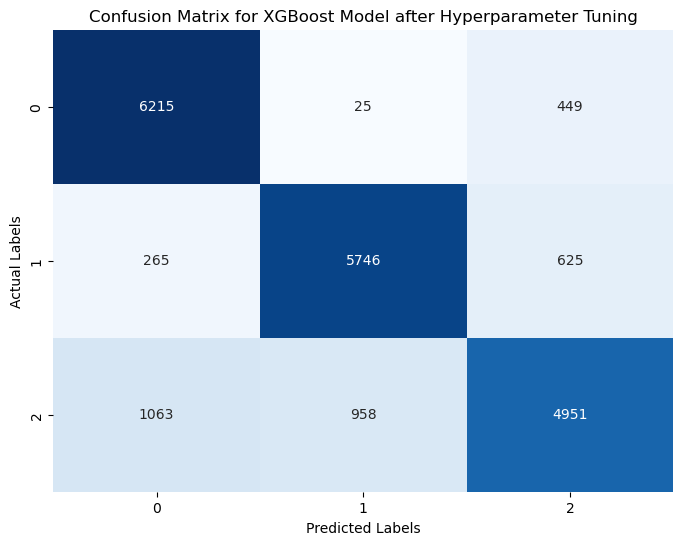

In [71]:
xgb_rscv_confusion = confusion_matrix(y_test, y_preds_xgb_rscv)

plt.figure(figsize=(8, 6))
sns.heatmap(xgb_rscv_confusion, annot=True, fmt='d', cmap='Blues', cbar=False)

plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix for XGBoost Model after Hyperparameter Tuning')

plt.show()

#### 3. Grid Search on Random Forest

In [72]:
# Setup grid hyperparameter search for Random Forest

rf_rscv = RandomizedSearchCV(RandomForestClassifier(random_state=24),
                         param_distributions=rf_grid,
                         cv=5, n_iter=100, verbose=True)


# Fit random hyperparameter search model for Random Forest

rf_rscv.fit(X_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(random_state=24),
                   n_iter=100,
                   param_distributions={'max_depth': [None, 3, 5, 10],
                                        'min_samples_leaf': array([ 1,  3,  5,  7,  9, 11, 13, 15, 17, 19]),
                                        'min_samples_split': array([ 2,  4,  6,  8, 10, 12, 14, 16, 18]),
                                        'n_estimators': array([10, 60])},
                   verbose=True)

In [73]:
rf_rscv.best_params_

{'n_estimators': 60,
 'min_samples_split': 2,
 'min_samples_leaf': 1,
 'max_depth': None}

In [74]:
y_preds_rf_rscv = rf_rscv.predict(X_test)

accuracy_rf_rscv = accuracy_score(y_test, y_preds_rf_rscv)

print(f'Accuracy: {accuracy_rf_rscv:.2f}')
print(classification_report(y_test, y_preds_rf_rscv))

Accuracy: 0.89
              precision    recall  f1-score   support

           0       0.88      0.97      0.92      6689
           1       0.88      0.94      0.91      6636
           2       0.92      0.76      0.83      6972

    accuracy                           0.89     20297
   macro avg       0.89      0.89      0.89     20297
weighted avg       0.89      0.89      0.89     20297



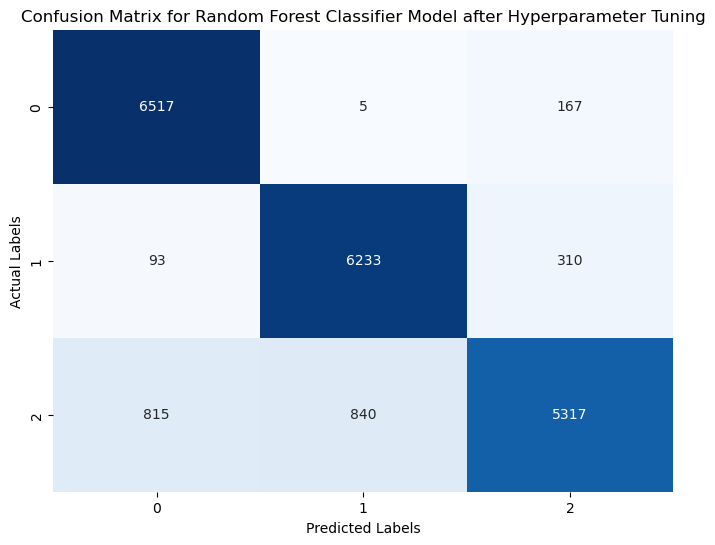

In [75]:
rf_rscv_confusion = confusion_matrix(y_test, y_preds_rf_rscv)

plt.figure(figsize=(8, 6))
sns.heatmap(rf_rscv_confusion, annot=True, fmt='d', cmap='Blues', cbar=False)

plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix for Random Forest Classifier Model after Hyperparameter Tuning')

plt.show()

### GridSearchCV model comparison

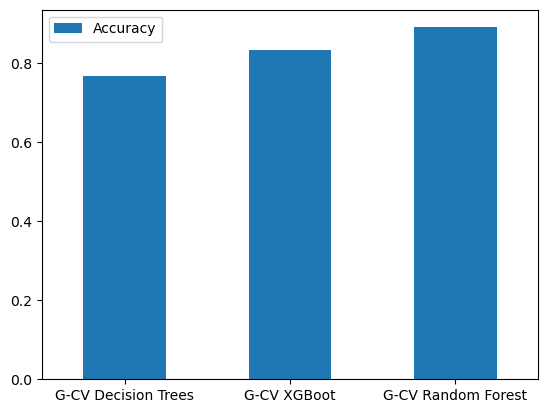

In [76]:
cv_modelvsbaseline = {"G-CV Decision Trees": accuracy_de_rscv,
                 "G-CV XGBoot": accuracy_xgb_rscv,
                 "G-CV Random Forest": accuracy_rf_rscv}

cv_modelvsbaseline_compare = pd.DataFrame(cv_modelvsbaseline, index=["Accuracy"])

cv_modelvsbaseline_compare.T.plot.bar()
plt.xticks(rotation = 0);

### GridSearchCV model comparison VS Baseline model comparison

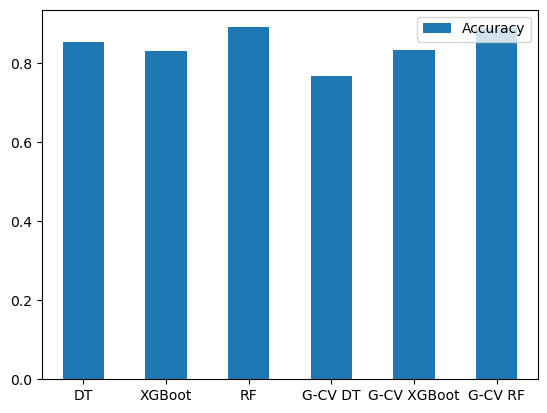

In [77]:
cv_model_scores = {"DT": accuracy_decision,
                   "XGBoot": accuracy_xgb,
                   "RF": accuracy_rdf,
                   "G-CV DT": accuracy_de_rscv,
                   "G-CV XGBoot": accuracy_xgb_rscv,
                   "G-CV RF": accuracy_rf_rscv}

cv_model_compare = pd.DataFrame(cv_model_scores, index=["Accuracy"])

cv_model_compare.T.plot.bar()
plt.xticks(rotation = 0);

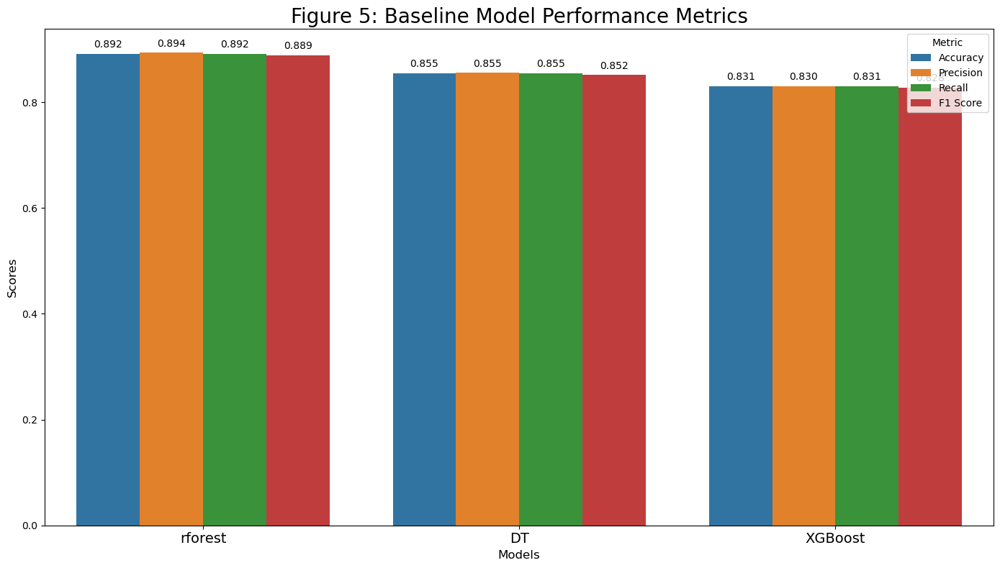

In [134]:
# Define the metrics

# metrics = {
#     "Accuracy": accuracy_score,
#     "Precision": precision_score,
#     "Recall": recall_score,
#     "F1 Score": f1_score
# }

# Define the metrics

metrics = {
    "Accuracy": accuracy_score,
    "Precision": lambda y_true, y_pred: precision_score(y_true, y_pred, average='weighted'),
    "Recall": lambda y_true, y_pred: recall_score(y_true, y_pred, average='weighted'),
    "F1 Score": lambda y_true, y_pred: f1_score(y_true, y_pred, average='weighted')
}

# Define the predictions

pred = {"rforest":y_preds_rdf,"DT":y_pred_decision,"XGBoost":y_pred_xgb}


# Calculate results
results = {}
for model_name, predictions in pred.items():
    results[model_name] = {metric_name: metric_func(y_test, predictions) for metric_name, metric_func in metrics.items()}

# Convert results to DataFrame
results_df1a = pd.DataFrame(results)



# Transpose the DataFrame for easier plotting with seaborn
results_df1a = results_df1a.T

# Reset index for seaborn
results_df1a.reset_index(inplace=True)

# Melt the DataFrame
results_df1a_melted = results_df1a.melt(id_vars="index", var_name="Metric", value_name="Score")
results_df1a_melted.rename(columns={"index": "Model"}, inplace=True)

# Ensure that "Score" column is numeric

results_df1a_melted["Score"] = pd.to_numeric(results_df1a_melted["Score"], errors='coerce')

# Plotting
plt.figure(figsize=(14, 8))

# Define a color palette
palette = sns.color_palette("tab10") # sns.color_palette("colorblind", len(metrics))



# Create the barplot
barplot = sns.barplot(x="Model", y="Score", hue="Metric", data=results_df1a_melted, palette=palette)

# Adding title and labels
plt.title('Figure 5: Baseline Model Performance Metrics', fontsize=20)
plt.xlabel('Models', fontsize=12)
plt.ylabel('Scores', fontsize=12)

# Adding scores on each bar
for p in barplot.patches:
    barplot.annotate(format(p.get_height(), '.3f'),
                     (p.get_x() + p.get_width() / 2., p.get_height()),
                     ha='center', va='center',
                     xytext=(0, 9),
                     textcoords='offset points',
                     fontsize=10,
                     color='black')

# Enlarging the model names
barplot.set_xticklabels(barplot.get_xticklabels(), fontsize=14)

# Showing the plot
plt.tight_layout()
plt.show()

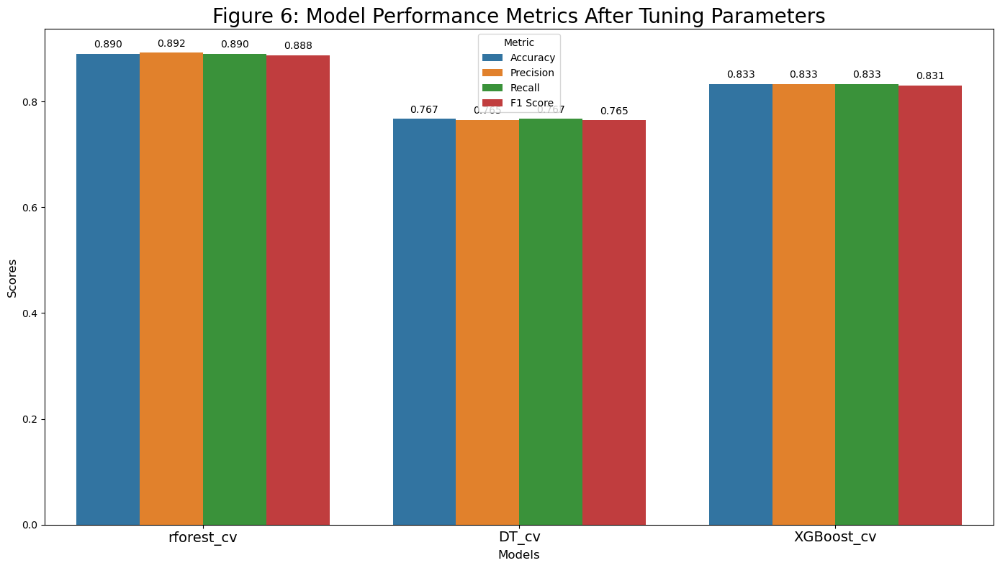

In [135]:
# Define the metrics

# metrics = {
#     "Accuracy": accuracy_score,
#     "Precision": precision_score,
#     "Recall": recall_score,
#     "F1 Score": f1_score
# }

# Define the metrics

metrics = {
    "Accuracy": accuracy_score,
    "Precision": lambda y_true, y_pred: precision_score(y_true, y_pred, average='weighted'),
    "Recall": lambda y_true, y_pred: recall_score(y_true, y_pred, average='weighted'),
    "F1 Score": lambda y_true, y_pred: f1_score(y_true, y_pred, average='weighted')
}

# Define the predictions

pred = {"rforest_cv":y_preds_rf_rscv,"DT_cv":y_preds_de_rscv,"XGBoost_cv":y_preds_xgb_rscv}


# Calculate results
results = {}
for model_name, predictions in pred.items():
    results[model_name] = {metric_name: metric_func(y_test, predictions) for metric_name, metric_func in metrics.items()}

# Convert results to DataFrame
results_df1a = pd.DataFrame(results)



# Transpose the DataFrame for easier plotting with seaborn
results_df1a = results_df1a.T

# Reset index for seaborn
results_df1a.reset_index(inplace=True)

# Melt the DataFrame
results_df1a_melted = results_df1a.melt(id_vars="index", var_name="Metric", value_name="Score")
results_df1a_melted.rename(columns={"index": "Model"}, inplace=True)

# Ensure that "Score" column is numeric

results_df1a_melted["Score"] = pd.to_numeric(results_df1a_melted["Score"], errors='coerce')

# Plotting
plt.figure(figsize=(14, 8))

# Define a color palette
palette = sns.color_palette("tab10") # sns.color_palette("colorblind", len(metrics))



# Create the barplot
barplot = sns.barplot(x="Model", y="Score", hue="Metric", data=results_df1a_melted, palette=palette)

# Adding title and labels
plt.title('Figure 6: Model Performance Metrics After Tuning Parameters', fontsize=20)
plt.xlabel('Models', fontsize=12)
plt.ylabel('Scores', fontsize=12)

# Adding scores on each bar
for p in barplot.patches:
    barplot.annotate(format(p.get_height(), '.3f'),
                     (p.get_x() + p.get_width() / 2., p.get_height()),
                     ha='center', va='center',
                     xytext=(0, 9),
                     textcoords='offset points',
                     fontsize=10,
                     color='black')

# Enlarging the model names
barplot.set_xticklabels(barplot.get_xticklabels(), fontsize=14)

# Showing the plot
plt.tight_layout()
plt.show()

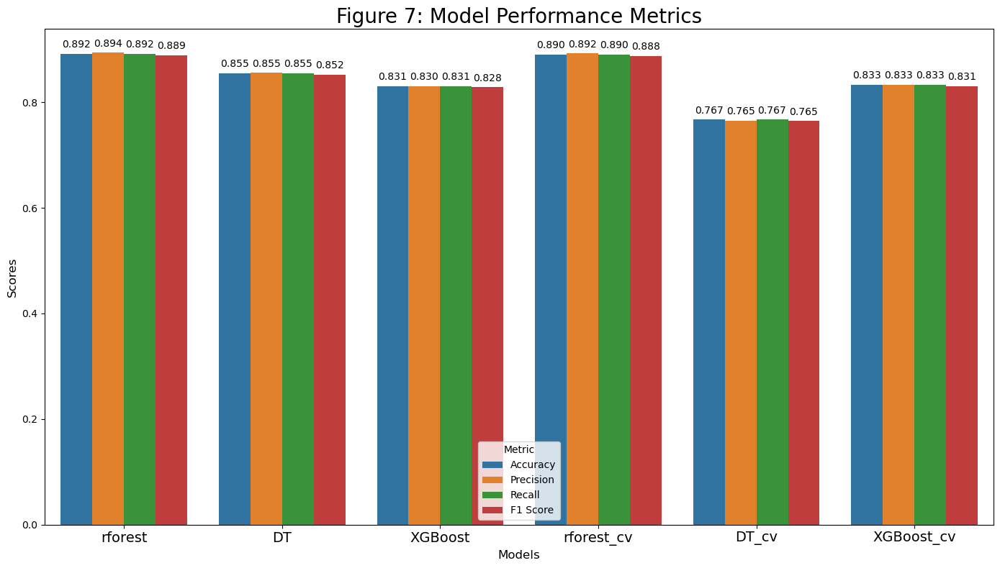

In [136]:
# Define the metrics

# metrics = {
#     "Accuracy": accuracy_score,
#     "Precision": precision_score,
#     "Recall": recall_score,
#     "F1 Score": f1_score
# }

# Define the metrics

metrics = {
    "Accuracy": accuracy_score,
    "Precision": lambda y_true, y_pred: precision_score(y_true, y_pred, average='weighted'),
    "Recall": lambda y_true, y_pred: recall_score(y_true, y_pred, average='weighted'),
    "F1 Score": lambda y_true, y_pred: f1_score(y_true, y_pred, average='weighted')
}

# Define the predictions

pred = {"rforest":y_preds_rdf,"DT":y_pred_decision,"XGBoost":y_pred_xgb,
            "rforest_cv":y_preds_rf_rscv,"DT_cv":y_preds_de_rscv,"XGBoost_cv":y_preds_xgb_rscv}


# Calculate results
results = {}
for model_name, predictions in pred.items():
    results[model_name] = {metric_name: metric_func(y_test, predictions) for metric_name, metric_func in metrics.items()}

# Convert results to DataFrame
results_df1a = pd.DataFrame(results)



# Transpose the DataFrame for easier plotting with seaborn
results_df1a = results_df1a.T

# Reset index for seaborn
results_df1a.reset_index(inplace=True)

# Melt the DataFrame
results_df1a_melted = results_df1a.melt(id_vars="index", var_name="Metric", value_name="Score")
results_df1a_melted.rename(columns={"index": "Model"}, inplace=True)

# Ensure that "Score" column is numeric

results_df1a_melted["Score"] = pd.to_numeric(results_df1a_melted["Score"], errors='coerce')

# Plotting
plt.figure(figsize=(14, 8))

# Define a color palette
palette = sns.color_palette("tab10") # sns.color_palette("colorblind", len(metrics))



# Create the barplot
barplot = sns.barplot(x="Model", y="Score", hue="Metric", data=results_df1a_melted, palette=palette)

# Adding title and labels
plt.title('Figure 7: Model Performance Metrics', fontsize=20)
plt.xlabel('Models', fontsize=12)
plt.ylabel('Scores', fontsize=12)

# Adding scores on each bar
for p in barplot.patches:
    barplot.annotate(format(p.get_height(), '.3f'),
                     (p.get_x() + p.get_width() / 2., p.get_height()),
                     ha='center', va='center',
                     xytext=(0, 9),
                     textcoords='offset points',
                     fontsize=10,
                     color='black')

# Enlarging the model names
barplot.set_xticklabels(barplot.get_xticklabels(), fontsize=14)

# Showing the plot
plt.tight_layout()
plt.show()

## Explainable AI Techniques

#### 1. Implementing DiCE - Diverse Counterfactual Explanations (DiCE) for ML

In [78]:
outcome_name = "Credit_Score"
continuous_features_subset = df.drop(outcome_name, axis=1).columns.tolist()
target = df[outcome_name]

In [79]:
d_rf = dice_ml.Data(dataframe=df,
                      continuous_features=continuous_features_subset,
                      outcome_name=outcome_name)

# We provide the type of model as a parameter (model_type)

m_rf = dice_ml.Model(model=rdf_model, backend="sklearn", model_type='classifier')

exp_genetic_rf = Dice(d_rf, m_rf, method="genetic")

In [80]:
X_test[2:3]

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,...,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments
85431,45,43742.01,3792.168,2,6,12,0,11,11.0,6.69,...,196.217148,442.999602,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [139]:
y_preds_rdf

array([0, 0, 2, ..., 1, 1, 2])

In [81]:
X_test[2:3].T

,85431
Age,45.000000
Annual_Income,43742.010000
Monthly_Inhand_Salary,3792.168000
Num_Bank_Accounts,2.000000
Num_Credit_Card,6.000000
Interest_Rate,12.000000
Num_of_Loan,0.000000
Delay_from_due_date,11.000000
Num_of_Delayed_Payment,11.000000
Changed_Credit_Limit,6.690000


In [82]:
y_test[4:5]

58229    0
Name: Credit_Score, dtype: int32

In [83]:
# Single input

query_instances_rf = X_test[2:3]

genetic_rf = exp_genetic_rf.generate_counterfactuals(query_instances_rf, total_CFs=5, desired_class=2)
genetic_rf.visualize_as_dataframe()

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.25s/it]

Query instance (original outcome : 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,...,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,45,43742.011719,3792.167969,2,6,12,0,11,11.0,6.69,...,442.999603,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,...,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,45,43742.01,3792.168,2,6,12,0,11,11.0,6.69,...,443.000,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2
0,46,43742.01,3792.168,2,6,12,0,11,8.0,8.69,...,479.080,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2
0,46,43742.01,3792.168,2,6,12,0,11,11.0,8.69,...,582.269,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2
0,53,43504.07,3767.339,5,4,2,2,13,3.0,6.76,...,359.067,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2
0,53,43504.07,3767.339,5,4,2,2,10,6.0,3.76,...,500.832,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2


In [84]:
# Single input

query_instances_rf3 = X_test[11:12]

genetic_rf3 = exp_genetic_rf.generate_counterfactuals(query_instances_rf3, total_CFs=5, desired_class=2)
genetic_rf3.visualize_as_dataframe()

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.33s/it]

Query instance (original outcome : 0)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,...,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,55,80027.679688,6652.973145,3,1,2,4,5,8.0,4.1,...,616.861023,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,...,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,55,80027.68,6652.973,3,1,2,4,5,8.0,4.10,...,631.781,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,55,79710.09,6375.508,3,4,16,3,21,12.0,4.85,...,639.087,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,55,79710.09,6375.508,3,4,16,3,21,12.0,1.85,...,589.227,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,19,79783.60,6535.543,3,4,15,3,25,9.0,15.60,...,1.730,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,26,79741.88,6748.157,3,7,10,4,7,7.0,6.08,...,656.115,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2


In [85]:
import pandas as pd

# Set display options to show all columns
pd.set_option('display.max_columns', None)

# Now visualize the DataFrame
genetic_rf3.visualize_as_dataframe()

Query instance (original outcome : 0)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,55,80027.679688,6652.973145,3,1,2,4,5,8.0,4.1,4.0,1,21.75,41.2356,331,204.154053,84.28228,616.861023,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,55,80027.68,6652.973,3,1,2,4,5,8.0,4.10,4.0,1,21.75,35.25142,330,204.2,69.4,631.781,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,55,79710.09,6375.508,3,4,16,3,21,12.0,4.85,4.0,2,109.97,42.21724,392,165.1,73.4,639.087,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,55,79710.09,6375.508,3,4,16,3,21,12.0,1.85,4.0,2,109.97,25.92295,391,165.1,123.3,589.227,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,19,79783.60,6535.543,3,4,15,3,25,9.0,15.60,10.0,1,225.23,30.81142,378,131.7,350.6,1.730,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,26,79741.88,6748.157,3,7,10,4,7,7.0,6.08,4.0,3,227.12,27.31081,300,207.1,51.6,656.115,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2


In [86]:
print(genetic_rf3)

In [87]:
X_test[17:19]

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments
52738,43,7854.74,698.561,8,8,20,7,47,22.0,9.31,11.0,0,1516.73,37.63307,175,28.636501,68.992881,262.226743,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
8541,46,50298.42,4391.535,9,5,22,5,28,16.0,1.47,7.0,0,3281.43,35.67986,24,195.264838,131.054375,372.834287,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0


In [88]:
# Multiple queries can be given as input at once

query_instances_rf2 = X_test[15:19]
genetic_rf2 = exp_genetic_rf.generate_counterfactuals(query_instances_rf2, total_CFs=5, desired_class=2)
genetic_rf2.visualize_as_dataframe(show_only_changes=True)

100%|████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:09<00:00,  2.36s/it]

Query instance (original outcome : 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,40,10585.099609,590.09198,8,4,6,4,27,8.0,8.85,5.0,2,0.56,28.514959,155,29.541637,31.408266,268.059265,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,2



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-
0,-,-,-,-,-,-,-,-,-,-,-,-,-,31.22515,-,-,-,288.056,-,-,-,-,-,0.0,-,1.0,-
0,-,-,-,-,-,-,-,-,7.0,-,-,-,-,36.18805,151.0,-,21.1,-,-,-,-,-,1.0,0.0,-,-,-
0,-,-,-,-,-,-,-,25.0,-,6.85,-,-,-,24.04415,149.0,-,19.0,260.497,-,-,-,1.0,-,0.0,-,-,-
0,-,-,-,-,-,-,-,24.0,-,-,-,-,-,38.63003,-,-,60.1,259.382,-,0.0,-,-,-,0.0,-,1.0,-


Query instance (original outcome : 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,31,12600.450195,782.036987,5,5,10,3,25,16.0,15.79,7.0,2,569.799988,23.179831,149,26.060349,32.026306,310.117065,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,2



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-
0,-,-,-,-,-,-,-100.0,-,18.0,-,-,-,-,38.15374,-,-,103.2,238.985,-,-,-,-,-,-,-,-,-
0,-,-,-,-,-,13.0,0.0,-,-,19.77,8.0,-,-,30.66269,68.0,-,0.0,-,-,-,-,-,-,-,-,-,-
0,-,-,897.719,-,-,-,0.0,6.0,18.0,-,0.0,-,-,25.282,-,0.0,82.0,238.985,-,-,-,-,-,-,-,-,-
0,-,-,-,8.0,-,11.0,-,19.0,-3.0,-6.44,-,-,845.79,33.57939,2.0,0.0,-,280.01,-,-,-,-,-,-,-,-,-


Query instance (original outcome : 1)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,43,7854.740234,698.560974,8,8,20,7,47,22.0,9.31,11.0,0,1516.72998,37.633072,175,28.636501,68.992882,262.226746,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,19.0,-,775.527,-,0.0,17.0,2.0,-5.0,13.0,-6.44,12.0,-,1796.83,25.40844,188.0,0.0,0.0,1.73,-,-,-,-,-,-,-,-,2.0
0,40.0,-,463.998,10.0,6.0,29.0,5.0,46.0,20.0,9.41,9.0,-,-,40.13547,139.0,24.1,50.3,-,-,-,-,-,-,-,-,-,2.0
0,41.0,-,463.998,10.0,6.0,29.0,5.0,49.0,18.0,7.41,9.0,-,-,28.80723,142.0,24.1,19.3,292.993,-,-,-,-,-,-,-,-,2.0
0,15.0,-,883.174,7.0,10.0,17.0,5.0,50.0,24.0,7.36,12.0,-,-,25.94762,188.0,30.0,70.3,278.03,-,-,-,-,-,-,-,-,2.0
0,17.0,-,759.182,5.0,6.0,1.0,-100.0,-5.0,10.0,16.19,7.0,-,-,39.63768,2.0,13.9,46.9,284.866,-,-,-,-,-,-,-,-,2.0


Query instance (original outcome : 1)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,46,50298.421875,4391.535156,9,5,22,5,28,16.0,1.47,7.0,0,3281.429932,35.679859,24,195.264832,131.054382,372.83429,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,45.0,-,-,10.0,6.0,27.0,6.0,35.0,-,21.66,11.0,-,-,28.70642,76.0,154.2,226.7,316.804,-,-,-,-,-,-,-,-,2.0
0,14.0,-,-,10.0,7.0,20.0,-,27.0,19.0,20.78,12.0,-,-,31.12948,88.0,149.0,113.7,413.512,-,-,-,-,-,-,-,-,2.0
0,14.0,-,-,10.0,7.0,20.0,-,30.0,19.0,20.78,12.0,-,-,30.44986,90.0,149.0,277.7,249.587,-,-,-,-,-,-,-,-,2.0
0,35.0,-,-,7.0,10.0,17.0,6.0,16.0,20.0,1.36,9.0,-,-,38.60191,43.0,212.0,116.9,357.368,-,-,-,-,-,-,-,-,2.0
0,45.0,-,-,10.0,6.0,27.0,6.0,35.0,18.0,16.66,11.0,-,-,40.65736,75.0,154.2,112.4,431.179,-,-,-,-,-,-,-,-,2.0


In [89]:
# Single input

pd.set_option('display.max_columns', None)

query_instances_rf9 = X_test[8:9]

genetic_rf9 = exp_genetic_rf.generate_counterfactuals(query_instances_rf9, total_CFs=5, desired_class=2)
genetic_rf9.visualize_as_dataframe()

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.12s/it]

Query instance (original outcome : 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,31,106928.84375,9110.737305,5,3,13,4,19,14.0,22.879999,10.0,3,619.73999,40.141911,204,240.733231,139.970184,770.370239,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,2



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,31,106928.84,9110.737,5,3,13,4,19,14.0,22.88,10.0,3,619.74,40.14191,204,240.7,140.0,770.370,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,31,106928.84,9110.737,5,3,13,4,19,11.0,15.88,8.0,3,619.74,35.05923,202,240.7,132.2,788.096,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,2
0,31,7005.93,303.645,-1,3,13,-100,19,14.0,7.77,0.0,3,0.23,33.62395,204,207.8,140.0,481.876,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,24,106666.20,9110.737,6,6,12,5,19,14.0,15.09,10.0,2,1288.06,36.70184,204,0.0,136.7,682.756,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,15,7005.93,8795.305,5,3,17,4,5,15.0,-6.44,10.0,3,619.74,21.26425,2,240.7,194.3,672.910,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2


In [140]:
# Feature Importance Visualization

import matplotlib.pyplot as plt

# Assuming `counterfactuals` is a DataFrame containing DiCE counterfactual explanations

feature_importance = d_rf.mean(axis=0)  # Calculate mean importance across counterfactuals
feature_importance.sort_values(ascending=False).plot(kind='bar')

plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importance in DiCE Counterfactuals')
plt.show()


AttributeError: 'PublicData' object has no attribute 'mean'

In [142]:
import matplotlib.pyplot as plt

# Assuming exp_genetic_rf is already defined

feature_importance_exp = exp_genetic_rf.data.dataset.dice_ml_data[0].get_feature_importance()

plt.barh(exp_genetic_rf.data.feature_names, feature_importance_exp)
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance in DiCE Counterfactuals')
plt.show()

AttributeError: 'DiceGenetic' object has no attribute 'data'

In [144]:
# Import necessary libraries

import matplotlib.pyplot as plt

# Generate counterfactual instances for a single input

query_instances_rf3 = X_test[11:12]  # Assuming X_test is your test dataset
genetic_rf3 = exp_genetic_rf.generate_counterfactuals(query_instances_rf3, total_CFs=5, desired_class=2)

# Visualize counterfactual instances as a DataFrame
cf_df = genetic_rf3.visualize_as_dataframe()

# Plot the counterfactual instances
plt.figure(figsize=(10, 6))
for i in range(len(cf_df)):
    plt.plot(cf_df.columns, cf_df.iloc[i], marker='o', label=f'CF {i+1}')
    
plt.xlabel('Features')
plt.ylabel('Feature Values')
plt.title('Counterfactual Instances')
plt.legend()
plt.show()

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:51<00:00, 51.03s/it]

Query instance (original outcome : 0)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,55,80027.679688,6652.973145,3,1,2,4,5,8.0,4.1,4.0,1,21.75,41.2356,331,204.154053,84.28228,616.861023,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,55,80027.68,6652.973,3,1,2,4,5,8.0,4.10,4.0,1,21.75,35.25142,330,204.2,69.4,631.781,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,55,79710.09,6375.508,3,4,16,3,21,12.0,4.85,4.0,2,109.97,42.21724,392,165.1,73.4,639.087,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,55,79710.09,6375.508,3,4,16,3,21,12.0,1.85,4.0,2,109.97,25.92295,391,165.1,123.3,589.227,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,26,79741.88,6748.157,3,7,10,4,7,7.0,6.08,4.0,3,227.12,27.31081,300,207.1,51.6,656.115,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,26,79741.88,6748.157,4,7,18,4,7,7.0,-6.44,7.0,2,0.23,37.19708,300,150.7,73.2,672.560,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2


TypeError: object of type 'NoneType' has no len()

<Figure size 1000x600 with 0 Axes>

In [150]:
# Save generated counterfactual examples to disk

genetic_rf3.cf_examples_list[0].final_cfs_df.to_csv(path_or_buf='counterfactuals.csv', index=False)

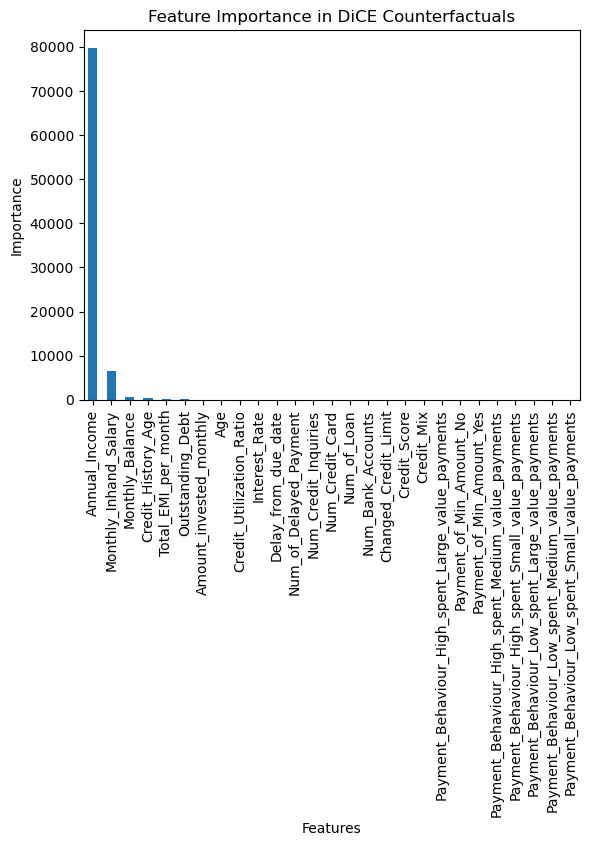

In [155]:
import matplotlib.pyplot as plt

counterfactuals = genetic_rf3.cf_examples_list[0].final_cfs_df

# Assuming `counterfactuals` is a DataFrame containing DiCE counterfactual explanations

feature_importance = counterfactuals.mean(axis=0)  # Calculate mean importance across counterfactuals
feature_importance.sort_values(ascending=False).plot(kind='bar')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importance in DiCE Counterfactuals')
plt.show()

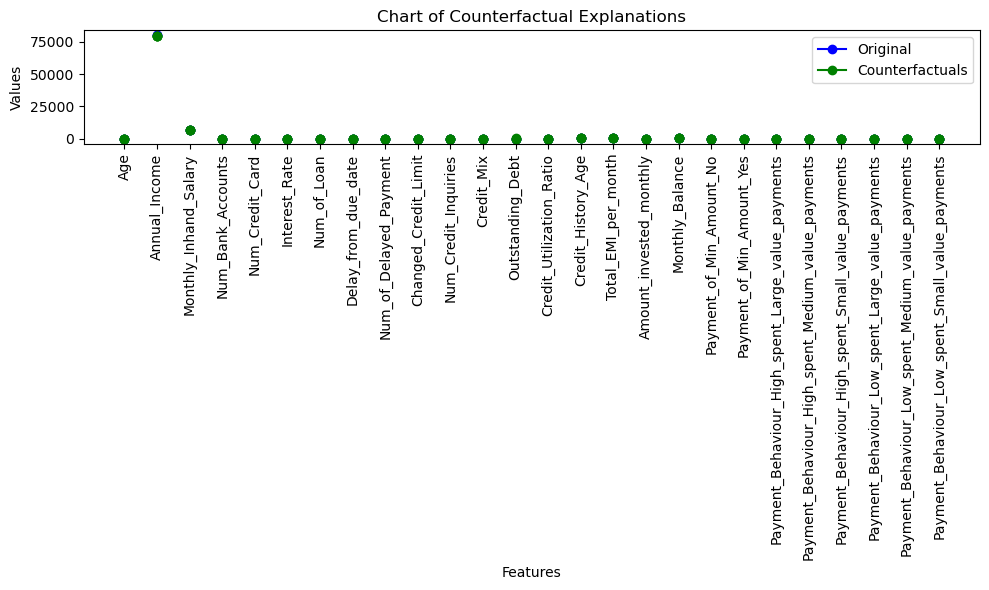

In [162]:
import matplotlib.pyplot as plt

# Assuming `original_instance` is the original input instance and `counterfactuals` contains DiCE counterfactuals
original_values = query_instances_rf3.values.flatten()
counterfactual_values = counterfactuals.values  # Assuming counterfactuals is a DataFrame containing counterfactual instances

# Number of features
num_features = len(original_values)

# Plot each feature
plt.figure(figsize=(10, 6))
for i in range(num_features):
    plt.plot([i, i], [original_values[i], counterfactual_values[0][i]], marker='o', color='b', label='Original')
    for cf_idx in range(1, len(counterfactual_values)):
        plt.plot(i, counterfactual_values[cf_idx][i], marker='o', color='g', label='Counterfactual')

# Customize plot
plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Chart of Counterfactual Explanations')
plt.xticks(range(num_features), query_instances_rf3.columns, rotation=90)
plt.legend(['Original', 'Counterfactuals'])
plt.tight_layout()
plt.show()

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:15<00:00, 15.41s/it]


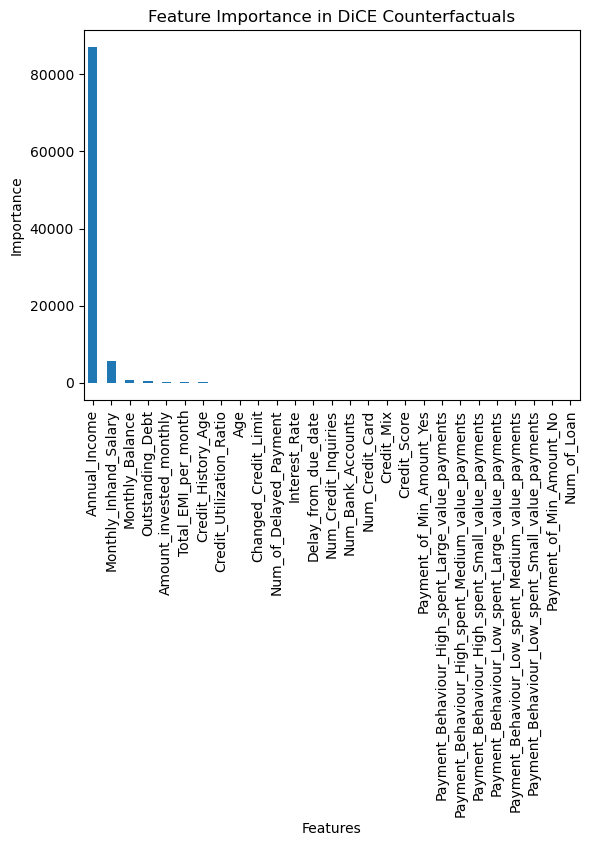

In [163]:
# Import necessary libraries

import matplotlib.pyplot as plt

# Generate counterfactual instances for a single input

query_instances_rf9 = X_test[8:9]  # Assuming X_test is your test dataset
genetic_rf9 = exp_genetic_rf.generate_counterfactuals(query_instances_rf9, total_CFs=5, desired_class=2)


import matplotlib.pyplot as plt

counterfactuals9 = genetic_rf9.cf_examples_list[0].final_cfs_df

# Assuming `counterfactuals` is a DataFrame containing DiCE counterfactual explanations

feature_importance = counterfactuals9.mean(axis=0)  # Calculate mean importance across counterfactuals
feature_importance.sort_values(ascending=False).plot(kind='bar')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importance in DiCE Counterfactuals')
plt.show()

In [166]:
genetic_rf9.visualize_as_dataframe()

Query instance (original outcome : 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,31,106928.84375,9110.737305,5,3,13,4,19,14.0,22.879999,10.0,3,619.73999,40.141911,204,240.733231,139.970184,770.370239,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,2



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,31,106928.84,9110.737,5,3,13,4,19,14.0,22.88,10.0,3,619.74,40.14191,204,240.7,140.0,770.370,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,31,107545.20,9110.737,5,7,9,4,-5,14.0,22.88,10.0,2,428.94,21.26425,245,0.0,140.0,770.370,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2
0,31,106928.84,9110.737,5,3,13,4,19,11.0,15.88,8.0,3,619.74,35.05923,202,240.7,132.2,788.096,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,2
0,23,106928.84,303.645,5,6,12,-100,-5,14.0,22.88,10.0,3,1288.06,35.56602,2,240.7,184.1,625.325,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2
0,14,7005.93,303.645,5,3,13,-100,24,11.0,-6.44,6.0,3,0.23,21.26425,2,0.0,132.2,672.910,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,2


In [167]:
query_instances_rf7 = X_test[6:7]  # Assuming X_test is your test dataset
genetic_rf7 = exp_genetic_rf.generate_counterfactuals(query_instances_rf7, total_CFs=5, desired_class=2)

genetic_rf7.visualize_as_dataframe()

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:31<00:00, 31.22s/it]

Query instance (original outcome : 1)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,28,46264.710938,3857.393066,8,9,27,7,51,15.0,-0.66,10.0,3,3025.100098,25.77347,144,249.029404,212.555496,194.154343,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1



Diverse Counterfactual set (new outcome: 2)


,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Payment_of_Min_Amount_No,Payment_of_Min_Amount_Yes,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments,Credit_Score
0,29,46264.71,3857.393,8,9,27,7,51,18.0,3.34,10.0,0,3025.10,28.41466,148,249.0,170.2,256.500,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,2
0,16,45245.52,3533.460,5,3,16,3,26,13.0,16.02,11.0,3,2057.39,30.89290,80,86.1,232.7,304.596,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,2
0,40,46003.29,3859.608,8,6,34,6,15,15.0,18.37,12.0,3,2681.08,28.06702,51,142.5,101.0,392.555,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2
0,22,46880.49,3790.708,6,7,23,5,42,17.0,6.37,10.0,0,2192.18,32.99502,230,106.7,232.6,309.773,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,2
0,23,47504.49,3760.708,8,7,28,6,47,21.0,9.55,8.0,0,2515.23,39.24456,134,146.0,118.9,381.098,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,2


#### 2.  Implementing ANCHOR XAI

In [90]:
# Convert the dataframe to a series

xx = X.values
yy = y.values

# retraining the model

xx_train, xx_test, yy_train, yy_test = train_test_split(
            xx, yy, test_size=0.2, random_state=42)

# Create a Random Forest classifier model

rf_model_xx = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model_xx.fit(xx_train, yy_train)

# Testing on the test data

yy_preds_rdf = rf_model_xx.predict(xx_test)

accuracy_rdf_xx = accuracy_score(yy_test, yy_preds_rdf)

print(f'Accuracy: {accuracy_rdf_xx:.2f}')
print(classification_report(yy_test, yy_preds_rdf))

Accuracy: 0.90
              precision    recall  f1-score   support

           0       0.89      0.98      0.94      4429
           1       0.89      0.96      0.92      4474
           2       0.94      0.78      0.85      4628

    accuracy                           0.90     13531
   macro avg       0.91      0.91      0.90     13531
weighted avg       0.91      0.90      0.90     13531



In [91]:
xx_test[0]

array([3.20000000e+01, 1.49241200e+04, 1.34767700e+03, 8.00000000e+00,
       7.00000000e+00, 1.60000000e+01, 2.00000000e+00, 2.00000000e+00,
       2.00000000e+01, 1.08000000e+01, 7.00000000e+00, 3.00000000e+00,
       2.27100000e+01, 2.39803300e+01, 1.35000000e+02, 1.99283650e+01,
       1.24876792e+02, 2.79962510e+02, 0.00000000e+00, 1.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 1.00000000e+00])

In [92]:
xx_test[0]

array([3.20000000e+01, 1.49241200e+04, 1.34767700e+03, 8.00000000e+00,
       7.00000000e+00, 1.60000000e+01, 2.00000000e+00, 2.00000000e+00,
       2.00000000e+01, 1.08000000e+01, 7.00000000e+00, 3.00000000e+00,
       2.27100000e+01, 2.39803300e+01, 1.35000000e+02, 1.99283650e+01,
       1.24876792e+02, 2.79962510e+02, 0.00000000e+00, 1.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 1.00000000e+00])

In [93]:
from anchor import anchor_tabular

# Define feature names

rf_feature_names = X.columns.tolist()

# Define class names

rf_class_names = ['Standard', 'Poor', 'Good']

# Define prediction function

# def predict_fn(x):
#     return rf_model_xx.predict(x)

# Initialize the anchor explainer

rf_anchor_explainer = anchor_tabular.AnchorTabularExplainer(rf_class_names, 
                                                            rf_feature_names, xx_train)

# Generate an explanation for a random instance from the test set

idx = 0
np.random.seed(24)

instance = xx_test[idx]
rf_explanation = rf_anchor_explainer.explain_instance(instance, rf_model_xx.predict, threshold=0.95)

# Print the explanation

print('Anchor: %s' % (' AND '.join(rf_explanation.names())))
print('Precision: %.2f' % rf_explanation.precision())
print('Coverage: %.2f' % rf_explanation.coverage())

Anchor: Outstanding_Debt <= 529.63 AND Payment_of_Min_Amount_Yes > 0.00 AND Credit_Mix > 2.00 AND Credit_History_Age <= 169.00
Precision: 0.96
Coverage: 0.00


In [94]:
instance2 = xx_test[5]
rf_explanation2 = rf_anchor_explainer.explain_instance(instance2, rf_model_xx.predict, threshold=0.95)

In [95]:
instance4 = xx_test[4]
rf_explanation4 = rf_anchor_explainer.explain_instance(instance4, rf_model_xx.predict, threshold=0.95)

In [96]:
instance11 = xx_test[11]
rf_explanation11 = rf_anchor_explainer.explain_instance(instance11, rf_model_xx.predict, threshold=0.95)

In [97]:
# Get test examples where the anchor applies

fit_anchor = np.where(np.all(xx_test[:, rf_explanation.features()] == xx_test[idx][rf_explanation.features()], axis=1))[0]

print('Anchor test precision: %.2f' % (np.mean(rf_model_xx.predict(xx_test[fit_anchor]) == rf_model_xx.predict(xx_test[idx].reshape(1, -1)))))
print('Anchor test coverage: %.2f' % (fit_anchor.shape[0] / float(xx_test.shape[0])))

Anchor test precision: 1.00
Anchor test coverage: 0.00


In [98]:
# Looking at a partial anchor

print('Partial anchor: %s' % (' AND '.join(rf_explanation.names(1))))
print('Partial precision: %.2f' % rf_explanation.precision(1))
print('Partial coverage: %.2f' % rf_explanation.coverage(1))

Partial anchor: Outstanding_Debt <= 529.63 AND Payment_of_Min_Amount_Yes > 0.00
Partial precision: 0.80
Partial coverage: 0.06


In [99]:
fit_partial = np.where(np.all(xx_test[:, rf_explanation.features(1)] == xx_test[idx][rf_explanation.features(1)], axis=1))[0]

print('Partial anchor test precision: %.2f' % (np.mean(rf_model_xx.predict(xx_test[fit_partial]) == rf_model_xx.predict(xx_test[idx].reshape(1, -1)))))
print('Partial anchor test coverage: %.2f' % (fit_partial.shape[0] / float(xx_test.shape[0])))

Partial anchor test precision: 1.00
Partial anchor test coverage: 0.00


In [100]:
rf_explanation.show_in_notebook()

In [101]:
rf_explanation2.show_in_notebook()

In [102]:
rf_explanation4.show_in_notebook()

In [103]:
rf_explanation11.show_in_notebook()

#### 3. Implementing LIME

In [104]:
from aix360.algorithms.lime import LimeTabularExplainer

data = df.copy().iloc[:, :-1]
feature_names = df.columns.tolist()[:-1]  # Assuming the last column is the target variable
class_names = ['Standard', 'Poor', 'Good']  # Replace with your actual class names


# Instantiate the LimeTabularExplainer
lime_explainer = LimeTabularExplainer(data.values, 
                                  feature_names=feature_names, 
                                  class_names=class_names,
                                  mode = 'classification')  # You can set discretize_continuous=True if you want continuous features to be discretized

# Example explanation for the first instance in your data


first_lime_instance = data.values[0]  # Choose an instance from your dataset

lime_explanation = lime_explainer.explain_instance(first_lime_instance, 
                                          predict_fn=rdf_model.predict_proba,  # Replace model.predict with your own prediction function
                                          num_features=26)  # Number of features to include in explanation

# Print the explanation
print(lime_explanation.as_list())

[('Credit_Mix <= 1.00', 0.06961957448287091), ('Outstanding_Debt <= 530.70', -0.06569804146096873), ('9.00 < Delay_from_due_date <= 15.00', -0.03831300558772451), ('Interest_Rate <= 7.00', -0.02120022852186235), ('5.00 < Num_Credit_Card <= 7.00', 0.02063817148753616), ('2.00 < Num_Credit_Inquiries <= 5.00', -0.013650324734505241), ('Amount_invested_monthly > 201.72', 0.01280976821462256), ('Num_of_Delayed_Payment <= 8.00', 0.011549380867506408), ('0.00 < Payment_of_Min_Amount_No <= 1.00', -0.010632960481482217), ('3.00 < Num_Bank_Accounts <= 5.00', -0.01044224178526256), ('169.00 < Credit_History_Age <= 231.00', 0.009883332383900337), ('Payment_Behaviour_Low_spent_Medium_value_payments <= 0.00', -0.009692221822747432), ('Age > 42.00', -0.009381119206913788), ('Payment_Behaviour_Low_spent_Small_value_payments <= 0.00', -0.007912366058347598), ('27.85 < Credit_Utilization_Ratio <= 32.07', -0.0076476094103466894), ('Payment_Behaviour_High_spent_Large_value_payments <= 0.00', 0.00639212159

In [105]:
def visualize_aix360_explanation(explanation):
    """
    Visualize the explanation in the style of AIX360.
    
    Parameters:
    - explanation: List of tuples containing feature names and importance scores.
    
    Returns:
    - None (prints the visualization)
    """
    print("AIX360 Style Explanation:")
    print("-------------------------")
    for feat, score in explanation.as_list():
        print(f"Feature: {feat} | Importance: {score:.4f}")
    print("-------------------------")


# Visualize the explanation
visualize_aix360_explanation(lime_explanation)

AIX360 Style Explanation:
-------------------------
Feature: Credit_Mix <= 1.00 | Importance: 0.0696
Feature: Outstanding_Debt <= 530.70 | Importance: -0.0657
Feature: 9.00 < Delay_from_due_date <= 15.00 | Importance: -0.0383
Feature: Interest_Rate <= 7.00 | Importance: -0.0212
Feature: 5.00 < Num_Credit_Card <= 7.00 | Importance: 0.0206
Feature: 2.00 < Num_Credit_Inquiries <= 5.00 | Importance: -0.0137
Feature: Amount_invested_monthly > 201.72 | Importance: 0.0128
Feature: Num_of_Delayed_Payment <= 8.00 | Importance: 0.0115
Feature: 0.00 < Payment_of_Min_Amount_No <= 1.00 | Importance: -0.0106
Feature: 3.00 < Num_Bank_Accounts <= 5.00 | Importance: -0.0104
Feature: 169.00 < Credit_History_Age <= 231.00 | Importance: 0.0099
Feature: Payment_Behaviour_Low_spent_Medium_value_payments <= 0.00 | Importance: -0.0097
Feature: Age > 42.00 | Importance: -0.0094
Feature: Payment_Behaviour_Low_spent_Small_value_payments <= 0.00 | Importance: -0.0079
Feature: 27.85 < Credit_Utilization_Ratio <= 3

In [106]:
def visualize_aix360_explanation(explanation, class_names):
    """
    Visualize the explanation in the style of AIX360 for different classes.
    
    Parameters:
    - explanation: Lime Explanation object
    - class_names: List of class names
    
    Returns:
    - None (prints the visualization)
    """
    print("AIX360 Style Explanation:")
    print("-------------------------")
    for class_index, class_name in enumerate(class_names):
        print(f"Class: {class_name}")
        print("-------------------------")
        try:
            class_explanation = explanation.as_list(class_index)
            for feat, score in class_explanation:
                print(f"Feature: {feat} | Importance: {score:.4f}")
        except KeyError:
            print("Explanation not available for this class.")
        print("-------------------------")

# Visualize the explanation for different classes
visualize_aix360_explanation(lime_explanation, class_names)

AIX360 Style Explanation:
-------------------------
Class: Standard
-------------------------
Explanation not available for this class.
-------------------------
Class: Poor
-------------------------
Feature: Credit_Mix <= 1.00 | Importance: 0.0696
Feature: Outstanding_Debt <= 530.70 | Importance: -0.0657
Feature: 9.00 < Delay_from_due_date <= 15.00 | Importance: -0.0383
Feature: Interest_Rate <= 7.00 | Importance: -0.0212
Feature: 5.00 < Num_Credit_Card <= 7.00 | Importance: 0.0206
Feature: 2.00 < Num_Credit_Inquiries <= 5.00 | Importance: -0.0137
Feature: Amount_invested_monthly > 201.72 | Importance: 0.0128
Feature: Num_of_Delayed_Payment <= 8.00 | Importance: 0.0115
Feature: 0.00 < Payment_of_Min_Amount_No <= 1.00 | Importance: -0.0106
Feature: 3.00 < Num_Bank_Accounts <= 5.00 | Importance: -0.0104
Feature: 169.00 < Credit_History_Age <= 231.00 | Importance: 0.0099
Feature: Payment_Behaviour_Low_spent_Medium_value_payments <= 0.00 | Importance: -0.0097
Feature: Age > 42.00 | Import

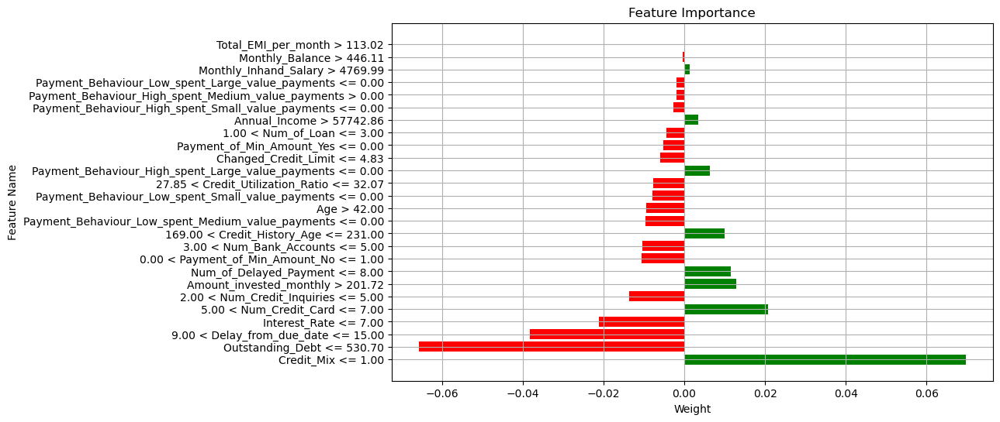

In [107]:
# Extract feature names and weights from lime_explanation.as_list()

lime_explanation_list = lime_explanation.as_list()
feature_names = [feat for feat, _ in lime_explanation_list]
weights = [weight for _, weight in lime_explanation_list]

# Create bar chart

plt.figure(figsize=(10, 6))
plt.barh(feature_names, weights, color=['red' if w < 0 else 'green' for w in weights])

plt.xlabel('Weight')
plt.ylabel('Feature Name')
plt.title('Feature Importance')

plt.grid(True)
plt.show()

In [108]:
# Example: Generate explanation for a specific instance

first_instance_index = 0  # Index of the instance you want to explain

first_explanation = lime_explainer.explain_instance(X_test.values[first_instance_index], 
                                         rdf_model.predict_proba)

# Visualize explanation in a notebook

first_explanation.show_in_notebook()

In [109]:
# Example: Generate explanation for a specific instance

instance_index = 3  # Index of the instance you want to explain

lime_new_explanation = lime_explainer.explain_instance(X_test.values[instance_index], 
                                         rdf_model.predict_proba)

# Visualize explanation in a notebook

lime_new_explanation.show_in_notebook()

#### 4. Implementing SHAP - SHapley Additive exPlanations

In [110]:
# Initialize explainer object

shap_explainer = shap.TreeExplainer(rdf_model)

In [111]:
# Calculate SHAP values

shap_values = shap_explainer.shap_values(X_test)

print("explainer.expected_value shape:", shap_explainer.expected_value.shape)
print("SHAP values shape:", shap_values.shape)

explainer.expected_value shape: (3,)
SHAP values shape: (20297, 26, 3)


##### Summary Plot

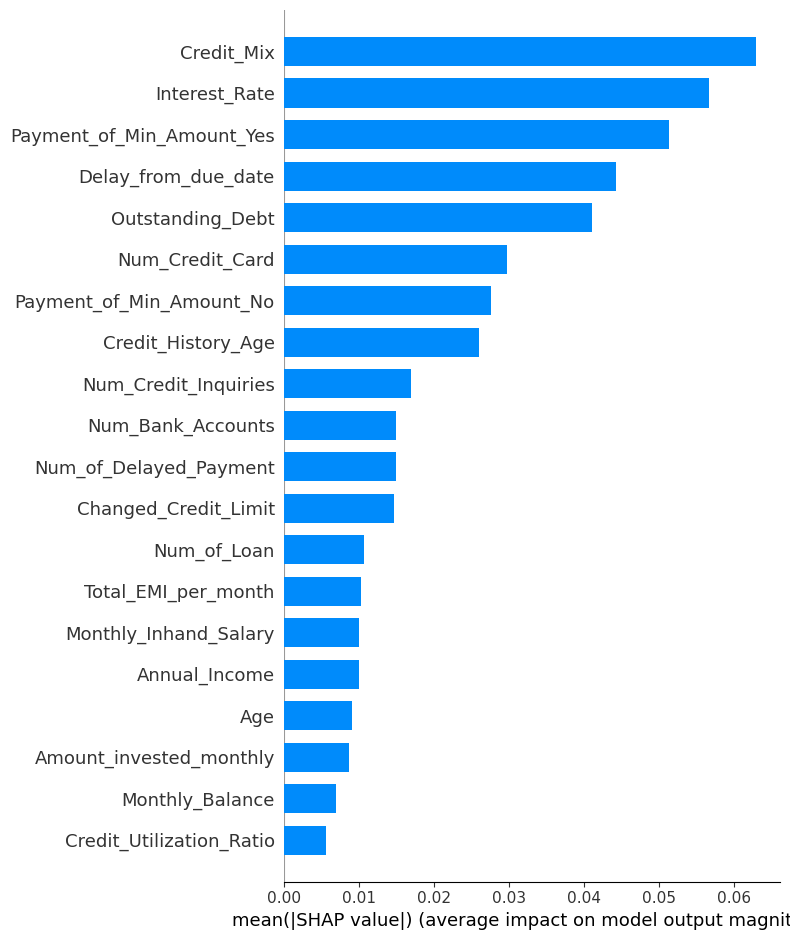

In [112]:
# Summarize the effects of features

shap.summary_plot(shap_values[:, :, 0], X_test, plot_type="bar")

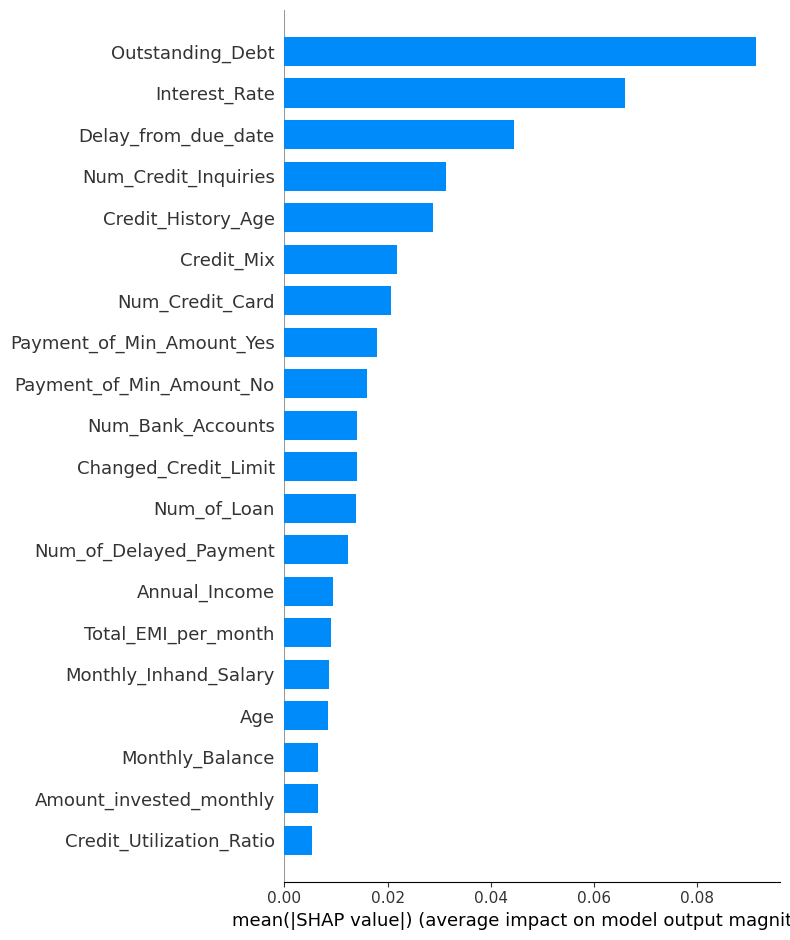

In [113]:
shap.summary_plot(shap_values[:, :, 1], X_test, plot_type="bar")

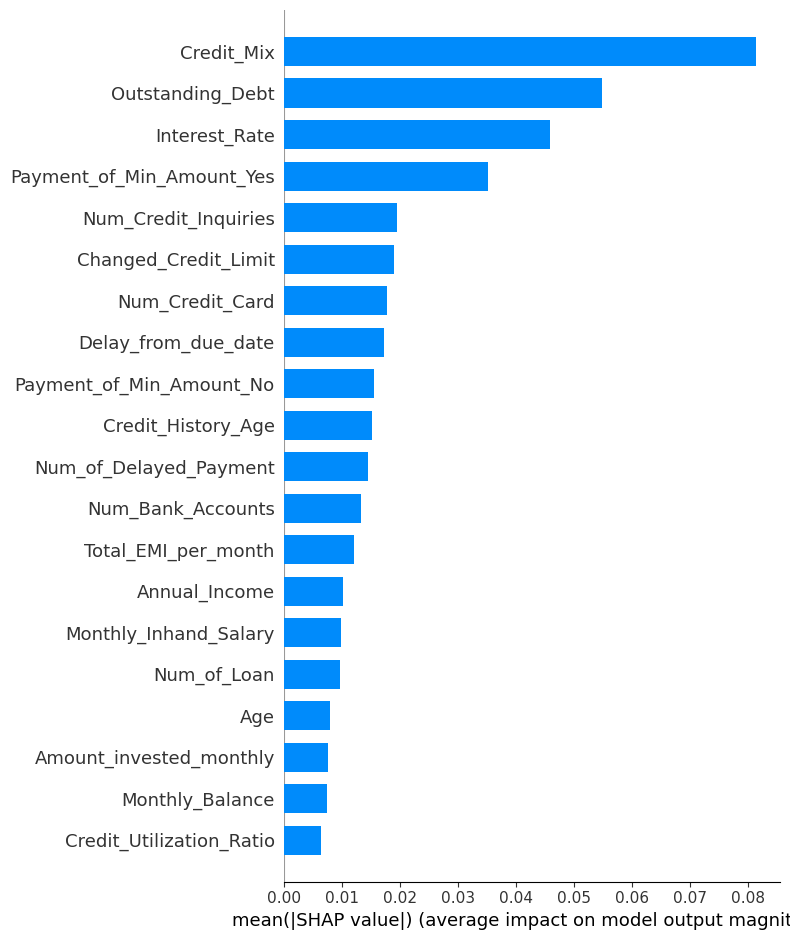

In [114]:
shap.summary_plot(shap_values[:, :, 2], X_test, plot_type="bar")

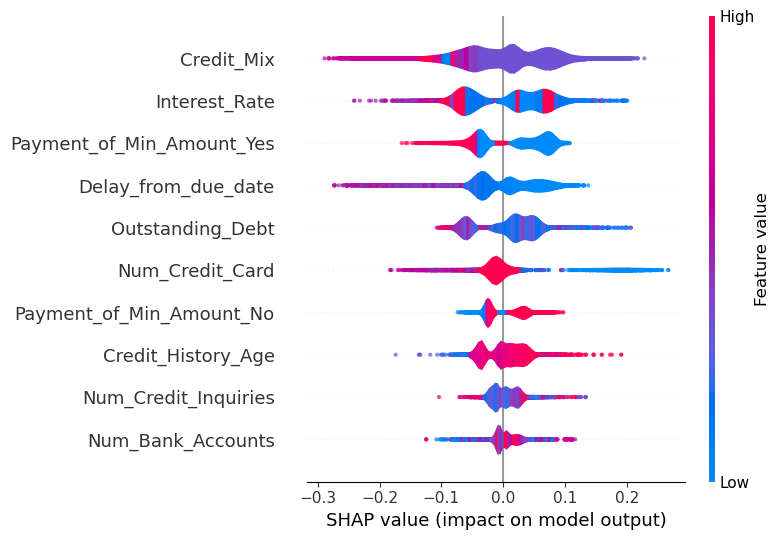

In [115]:
shap.summary_plot(shap_values[:, :, 0], X_test,
                   max_display=10,  # Display only top 10 features
                   plot_type='violin',  # Use violin plot
                   color='blue',  # Set color to blue
                   title='SHAP Summary Plot',  # Set title
                   alpha=0.7,  # Set transparency
                   show=False)  # Do not display immediately (useful if embedding in a report)

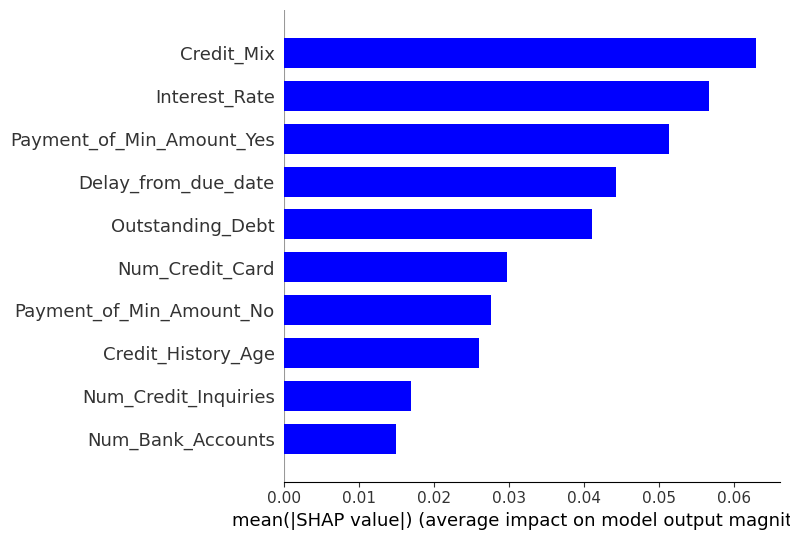

In [116]:
shap.summary_plot(shap_values[:, :, 0], X_test,
                   max_display=10,  # Display only top 10 features
                   plot_type='bar',  # Use violin plot
                   color='blue',  # Set color to blue
                   title='SHAP Summary Plot',  # Set title
                   alpha=0.7,  # Set transparency
                   show=False)  # Do not display immediately (useful if embedding in a report)

##### Dependence Plot

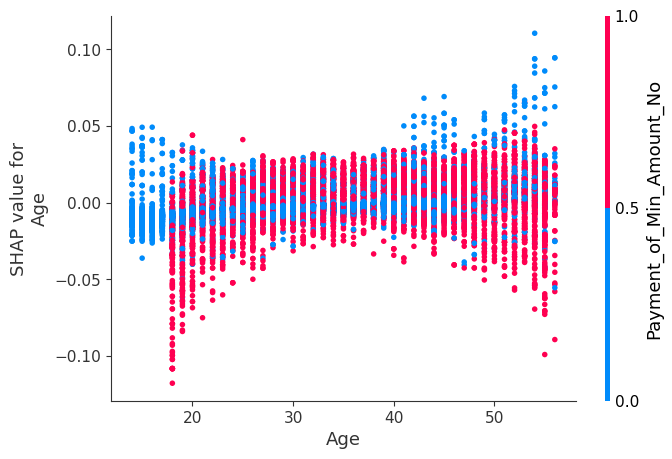

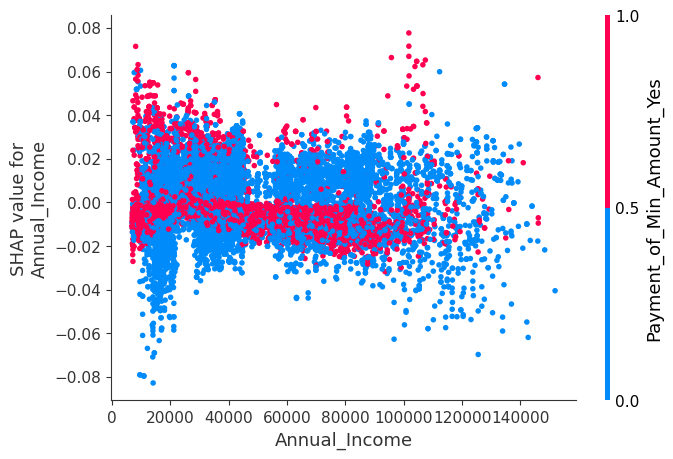

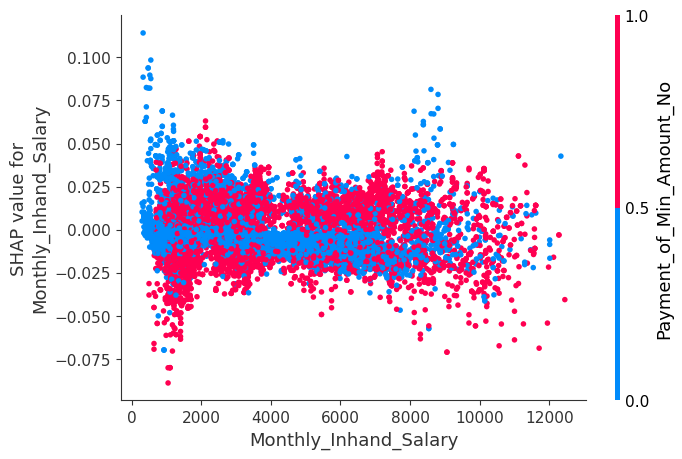

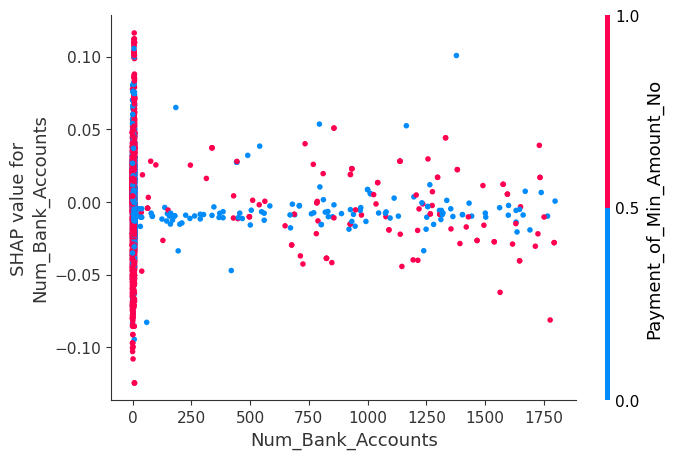

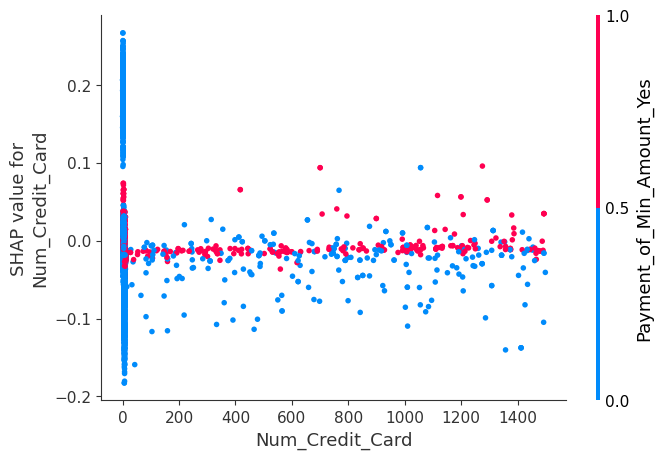

...

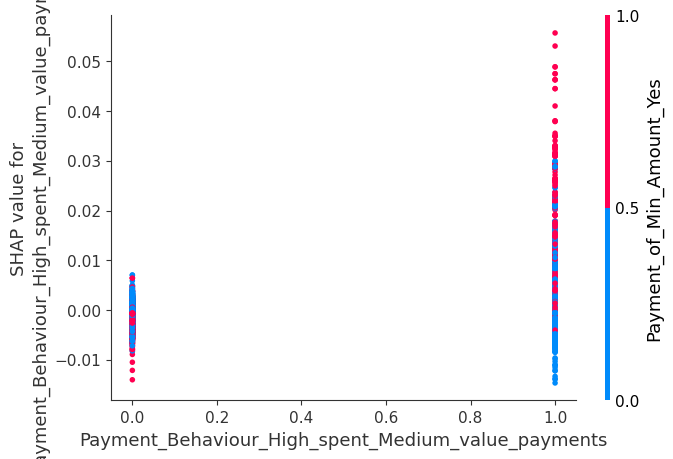

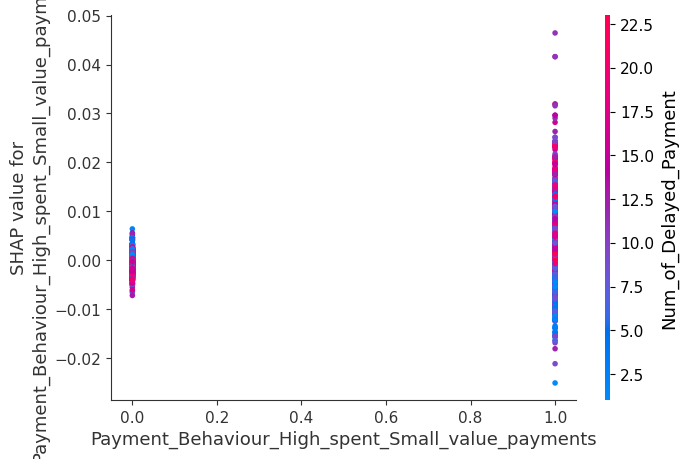

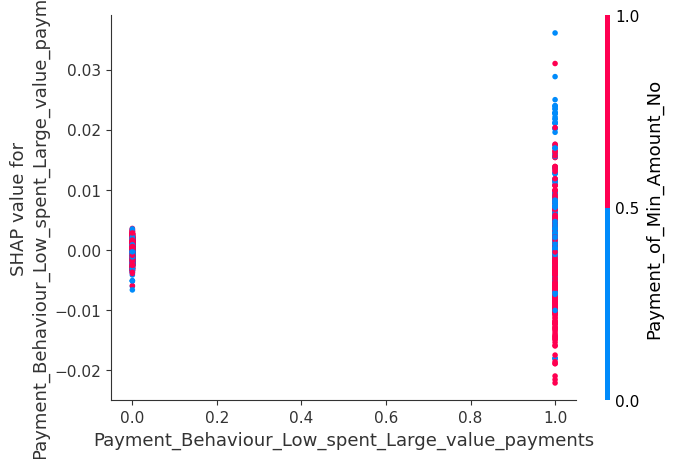

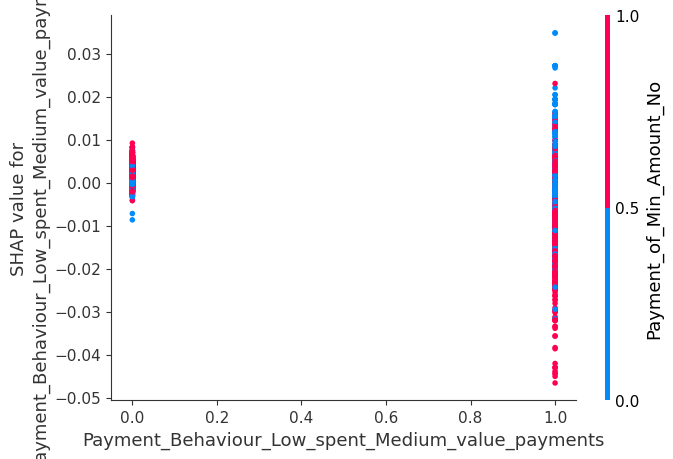

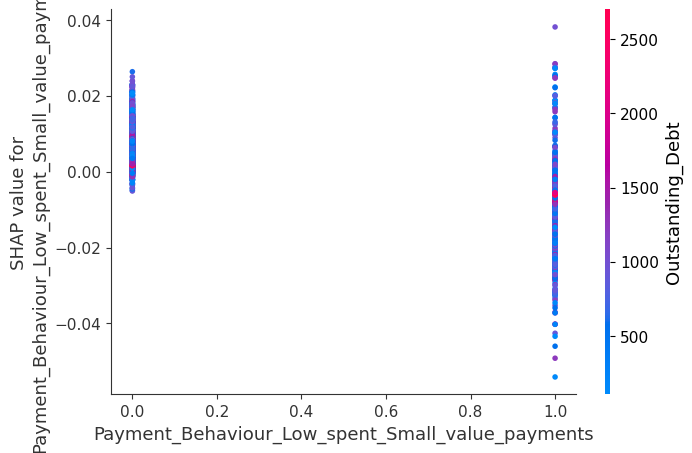

In [117]:
for name in X_test.columns:
    shap.dependence_plot(name, shap_values[:, :, 0], X_test, display_features=X_test)

In [118]:
X.columns

Index(['Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Monthly_Balance',
       'Payment_of_Min_Amount_No', 'Payment_of_Min_Amount_Yes',
       'Payment_Behaviour_High_spent_Large_value_payments',
       'Payment_Behaviour_High_spent_Medium_value_payments',
       'Payment_Behaviour_High_spent_Small_value_payments',
       'Payment_Behaviour_Low_spent_Large_value_payments',
       'Payment_Behaviour_Low_spent_Medium_value_payments',
       'Payment_Behaviour_Low_spent_Small_value_payments'],
      dtype='object')

##### Force Plot

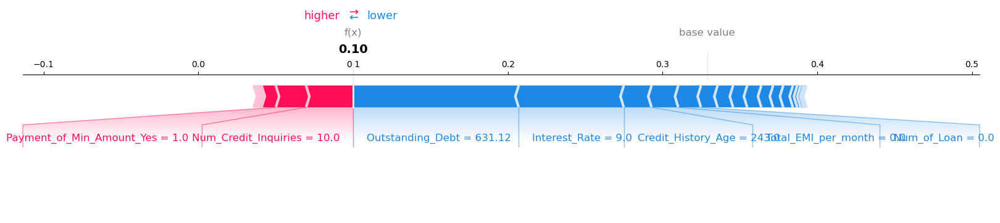

In [119]:
shap.force_plot(shap_explainer.expected_value[1],
               shap_values[12, :, 1],
               X_test.iloc[12, :], matplotlib = True)

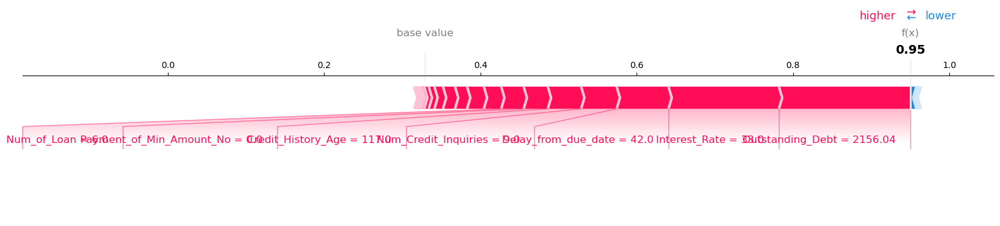

In [120]:
shap.force_plot(shap_explainer.expected_value[1],
               shap_values[3, :, 1],
               X_test.iloc[3, :], matplotlib = True)

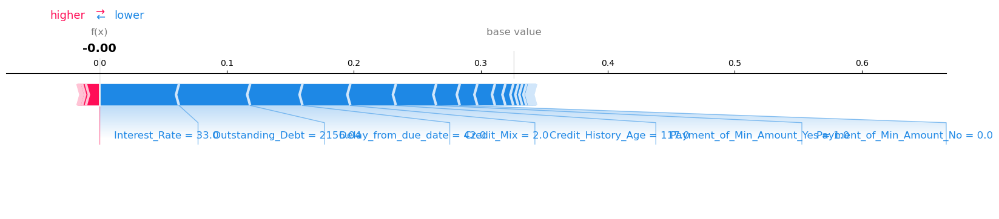

In [121]:
shap.force_plot(shap_explainer.expected_value[0],
               shap_values[3, :, 0],
               X_test.iloc[3, :], matplotlib = True)

In [122]:
# shap.force_plot(shap_explainer.expected_value[1],
#                shap_values[:, :, 1],
#                X_test)

##### Decision Plot

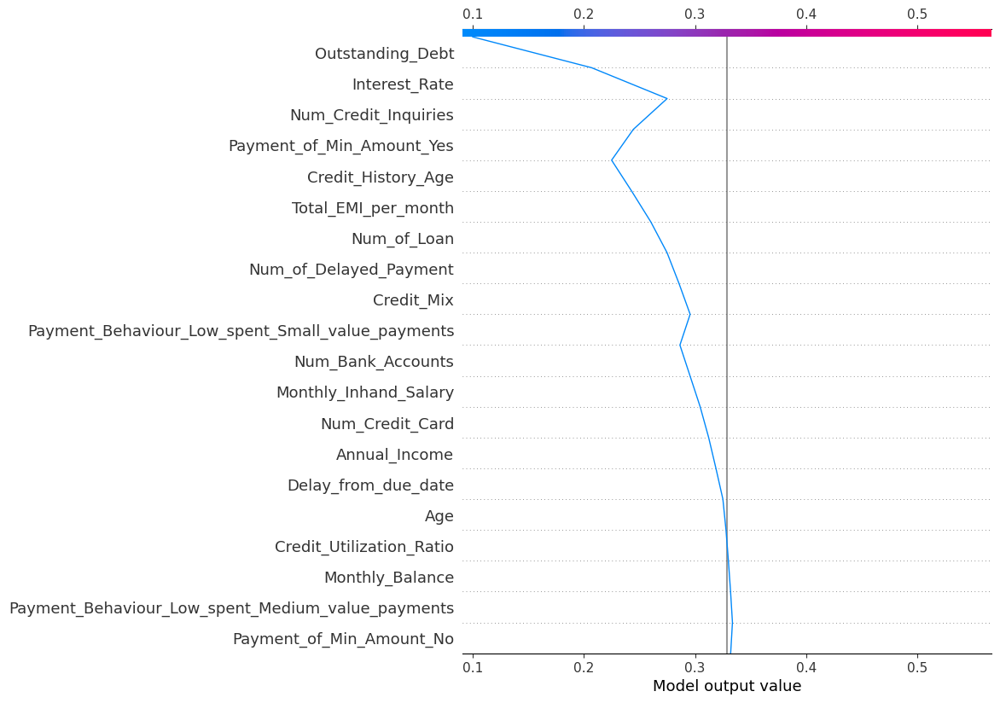

In [123]:
shap.decision_plot(shap_explainer.expected_value[1],
                   shap_values[12, :, 1],
                   X_test.columns)

In [124]:
creditscore["Credit_Mix"].value_counts()

2    22809
1    15059
3    12597
0    11759
Name: Credit_Mix, dtype: int64

In [125]:
y_test.head(20)

90267    0
22110    2
85431    2
91533    1
58229    0
45167    0
30620    1
57383    2
31589    2
27101    1
65087    1
57846    0
26873    2
27162    0
9920     1
2007     2
28959    2
52738    1
8541     1
49286    0
Name: Credit_Score, dtype: int32

In [126]:
print(y_preds_rdf[:20])

[0 0 2 1 0 0 1 2 2 1 1 0 2 0 1 2 2 1 1 0]
